In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
import sys
import os

import numpy as np

import cv2
import h5py

from keras.models import Model
from keras.layers import Input, Lambda
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers import concatenate
from keras.optimizers import Adam
from keras import backend as K

Using TensorFlow backend.


In [4]:
import PIL
from PIL import Image
from skimage.measure import compare_psnr

In [5]:
def reflection_padding(x, padding):
    reflected = Lambda(lambda x: x[:, :, ::-1, :])(x)
    reflected = Lambda(lambda x: x[:, :, :padding[1], :])(reflected)
    upper_row = concatenate([x, reflected], axis=2)
    lower_row = Lambda(lambda x: x[:, ::-1, :, :])(upper_row)
    lower_row = Lambda(lambda x: x[:, :padding[0], :, :])(lower_row)
    padded = concatenate([upper_row, lower_row], axis=1)
    return padded

def conv_bn_relu(x, size, filters, kernel_size, strides):
    padding = [0, 0]
    padding[0] =  (int(size[0]/strides[0]) - 1) * strides[0] + kernel_size - size[0]
    padding[1] =  (int(size[1]/strides[1]) - 1) * strides[1] + kernel_size - size[1]
    x = reflection_padding(x, padding)

    x = Conv2D(filters, kernel_size, strides=strides)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    new_size = [int(size[0]/strides[0]), int(size[1]/strides[1])]
    return x, new_size

def down_sampling(x, size, filters, kernel_size):
    new_size = [size[0], size[1]]
    if size[0] % 2 != 0:
        x = reflection_padding(x, [1, 0])
        new_size[0] = size[0] + 1
    if size[1] % 2 != 0:
        x = reflection_padding(x, [0, 1])
        new_size[1] = size[1] + 1
    size = new_size
    x, size = conv_bn_relu(x, size, filters, kernel_size, (2, 2))
    x, size = conv_bn_relu(x, size, filters, kernel_size, (1, 1))
    return x, size

def upsample(x, size, inter):
    x = UpSampling2D(size=(2, 2))(x)
    if inter == "bilinear":
        x_padded = reflection_padding(x, (1, 1))
        x = Lambda(lambda x: (x[:, :-1, 1:, :] + x[:, 1:, :-1, :] + x[:, :-1, :-1, :] + x[:, :-1, :-1, :]) / 4.0)(x_padded)
    return x, [size[0]*2, size[1]*2]

def up_sampling(x, size, filters, kernel_size, inter):
    x, size = upsample(x, size, inter)
    x, size = conv_bn_relu(x, size, filters, kernel_size, (1, 1))
    x, size = conv_bn_relu(x, size, filters, 1, (1, 1))
    return x, size

def skip(x, size, filters, kernel_size):
    x, size = conv_bn_relu(x, size, filters, kernel_size, (1, 1))
    return x, size

def define_model(num_u, num_d, kernel_u, kernel_d, num_s, kernel_s, height, width, inter, lr, input_channel=32):
    depth = len(num_u)
    size = [height, width]

    inputs = Input(shape=(height, width, input_channel))

    x = inputs
    down_sampled = []
    sizes = [size]
    for i in range(depth):
        x, size = down_sampling(x, size, num_d[i], kernel_d[i])
        down_sampled.append(x)
        sizes.append(size)

    for i in range(depth-1, -1, -1):
        if num_s[i] != 0:
            skipped, size = skip(down_sampled[i], size, num_s[i], kernel_s[i])
            x = concatenate([x, skipped], axis=3)
        x, size = up_sampling(x, size, num_u[i], kernel_u[i], inter)

        if sizes[i] != size:
            x = Lambda(lambda x: x[:, :sizes[i][0], :sizes[i][1], :])(x)
            size = sizes[i]

    x = Conv2D(3, 1)(x)
    model = Model(inputs, x)

    return model

In [6]:
def squared_error(y_true, y_pred):
    return K.sum(K.square(y_pred - y_true))

def define_denoising_model(height, width):
    num_u = [128, 128, 128, 128, 128]
    num_d = [128, 128, 128, 128, 128]
    kernel_u = [3, 3, 3, 3, 3]
    kernel_d = [3, 3, 3, 3, 3]
    num_s = [4, 4, 4, 4, 4]
    kernel_s = [1, 1, 1, 1, 1]
    lr = 0.01
    inter = "bilinear"

    model = define_model(num_u, num_d, kernel_u, kernel_d, num_s, kernel_s, height, width, inter, lr)
    model.compile(loss=squared_error, optimizer=Adam(lr=lr))

    return model


def denoising(image):
    height, width = image.shape[:2]
    model = define_denoising_model(height, width)
    input_noise = np.random.uniform(0, 0.1, (1, height, width, 32))

    for i in range(1800):
        model.train_on_batch(input_noise + np.random.normal(0, 1/30.0, (height, width, 32)), image[None, :, :, :])

    return np.clip(model.predict(input_noise)[0], 0, 255).astype(np.uint8)


# Read Image

In [7]:
fname = 'data/denoising/F16_GT.png'
image = cv2.imread(fname)

In [8]:
height, width = image.shape[:2]

In [9]:
image.shape

(512, 512, 3)

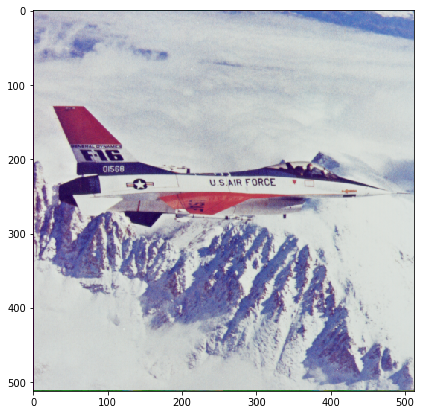

In [10]:
plt.figure(figsize=(7, 7))
img = image
plt.imshow(img[:,:,::-1])
plt.show()

In [11]:
image_noisy = np.clip((image/225. + np.random.normal(0, 1/30.0, (height, width, 3)))*255, 0, 255).astype(np.uint8)

In [13]:
input_noise = np.random.uniform(0, 0.1, (1, height, width, 32))

In [20]:
cv2.imwrite("input_noise.png", img)

True

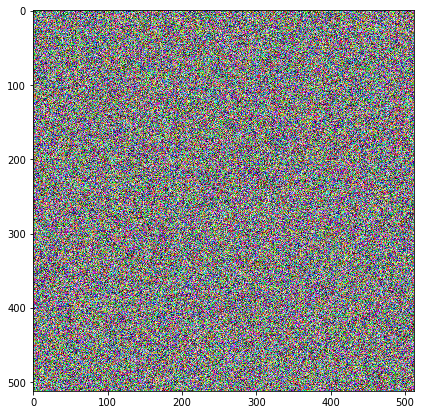

In [18]:
plt.figure(figsize=(7, 7))
img = input_noise[0,:,:,:3]*10
plt.imshow(img[:,:,::-1])
plt.show()

# Build

In [14]:
model = define_denoising_model(height, width)
input_noise = np.random.uniform(0, 0.1, (1, height, width, 32))

W0805 00:10:32.488111 4666549696 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0805 00:10:32.525673 4666549696 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0805 00:10:32.661061 4666549696 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0805 00:10:32.769790 4666549696 deprecation_wrapper.py:119] From /Users/lucasmeng/anaconda3/envs/py36/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Pl

In [15]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 32) 0                                            
__________________________________________________________________________________________________
lambda_1 (Lambda)               (None, 512, 512, 32) 0           input_1[0][0]                    
__________________________________________________________________________________________________
lambda_2 (Lambda)               (None, 512, 1, 32)   0           lambda_1[0][0]                   
__________________________________________________________________________________________________
concatenate_1 (Concatenate)     (None, 512, 513, 32) 0           input_1[0][0]                    
                                                                 lambda_2[0][0]                   
__________

# Train

Iter # 0 , PSRN NOISY:  4.655234791619839 ; PSRN GT:  5.513831563483961


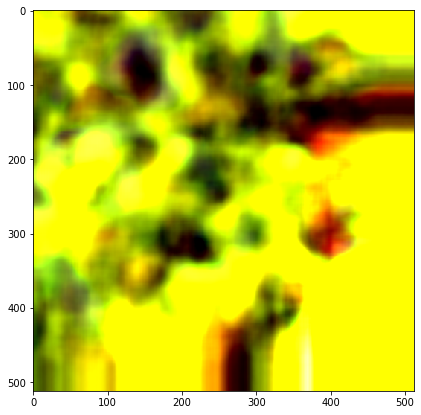

Iter # 10 , PSRN NOISY:  11.2931249974069 ; PSRN GT:  9.858633937802


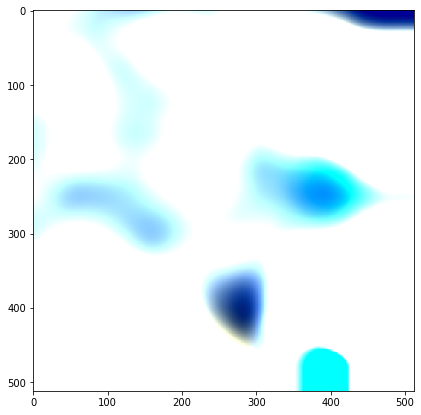

Iter # 20 , PSRN NOISY:  3.6274430304238297 ; PSRN GT:  4.792396072242097


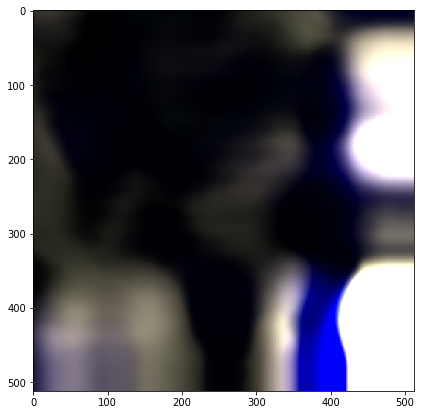

Iter # 30 , PSRN NOISY:  9.700255822315304 ; PSRN GT:  11.226447687449632


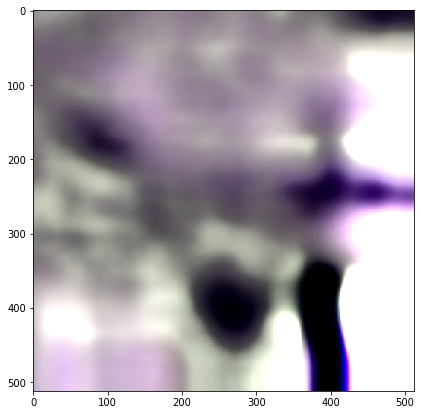

Iter # 40 , PSRN NOISY:  7.187200238735193 ; PSRN GT:  8.03424513480778


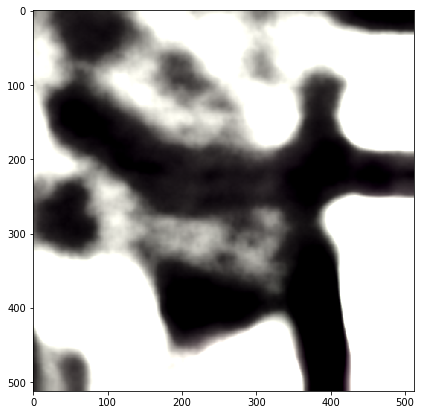

Iter # 50 , PSRN NOISY:  5.838080440695755 ; PSRN GT:  6.591835831846242


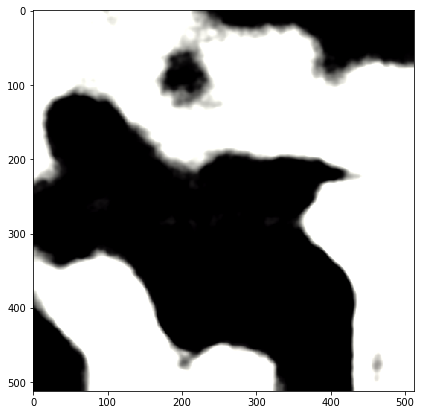

Iter # 60 , PSRN NOISY:  10.534537091211163 ; PSRN GT:  9.250939033359625


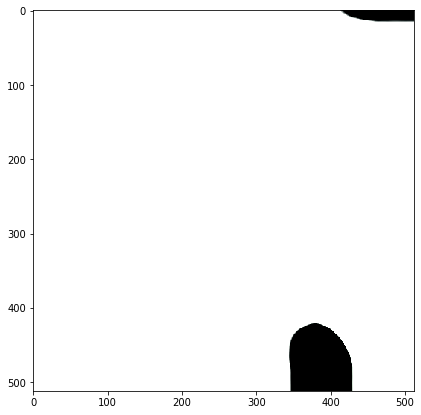

Iter # 70 , PSRN NOISY:  9.736174281852772 ; PSRN GT:  9.057491243338777


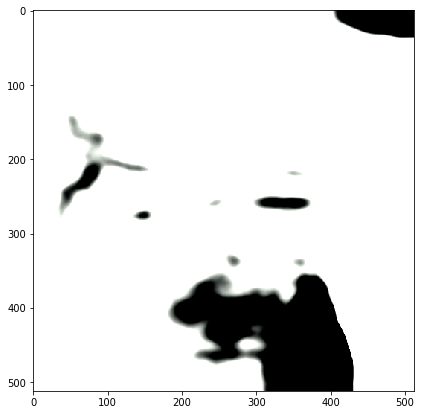

Iter # 80 , PSRN NOISY:  2.195032655530171 ; PSRN GT:  3.2568447835476193


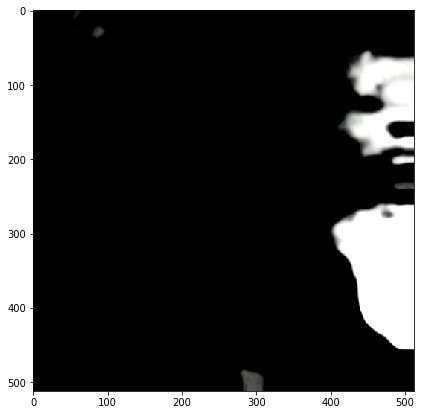

Iter # 90 , PSRN NOISY:  8.480818029724423 ; PSRN GT:  9.60267954682052


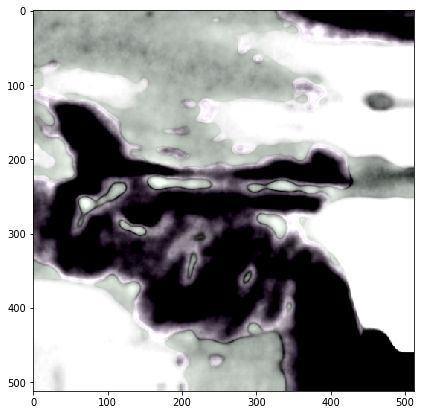

Iter # 100 , PSRN NOISY:  13.994301572607704 ; PSRN GT:  13.424602788794463


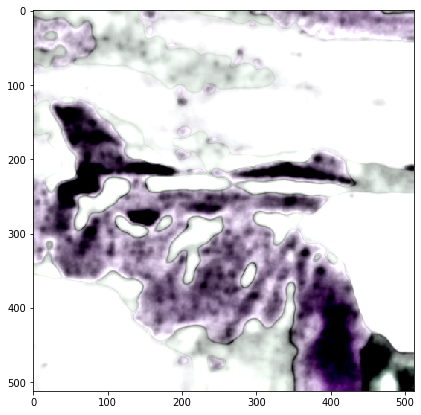

Iter # 110 , PSRN NOISY:  15.037433168998355 ; PSRN GT:  13.690178540941982


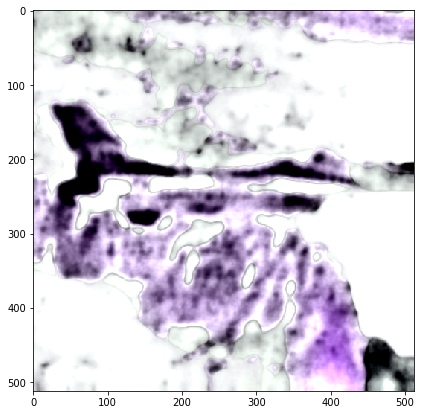

Iter # 120 , PSRN NOISY:  14.751206509357877 ; PSRN GT:  12.82803722760155


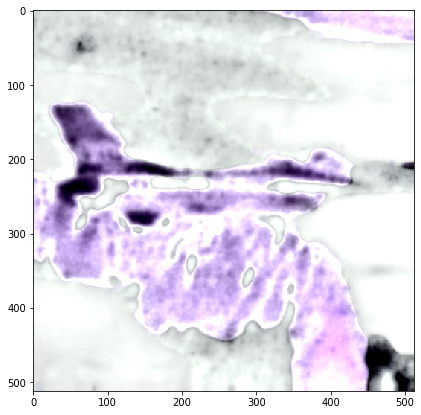

Iter # 130 , PSRN NOISY:  16.770038953910763 ; PSRN GT:  16.261975361938987


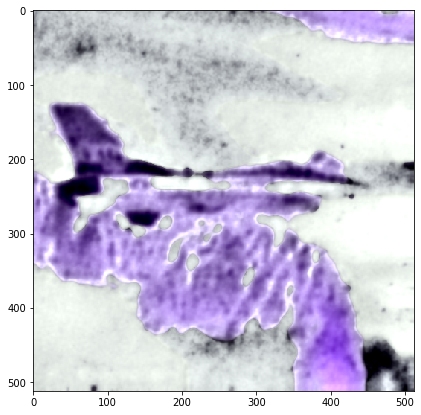

Iter # 140 , PSRN NOISY:  16.792646729233958 ; PSRN GT:  16.842588339715945


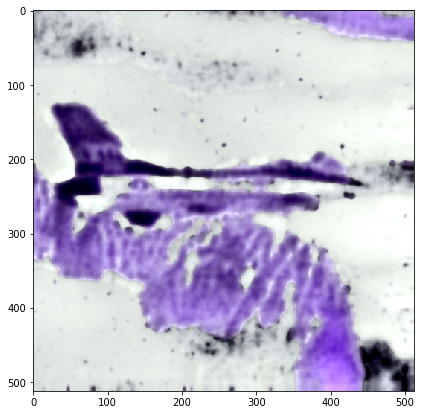

Iter # 150 , PSRN NOISY:  17.74257198570645 ; PSRN GT:  17.58524323099891


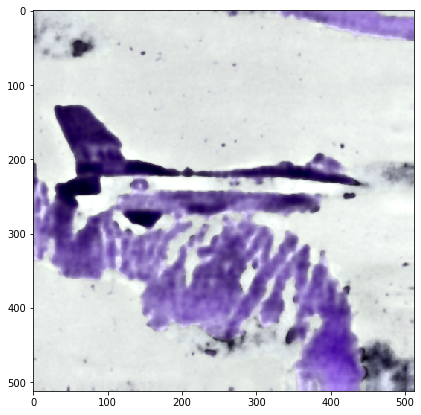

Iter # 160 , PSRN NOISY:  19.330360844469162 ; PSRN GT:  18.83631876048571


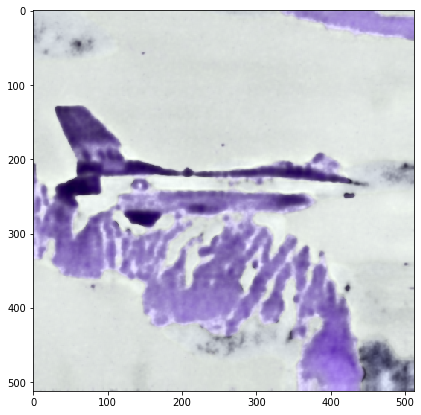

Iter # 170 , PSRN NOISY:  16.904688852666613 ; PSRN GT:  18.855219715311158


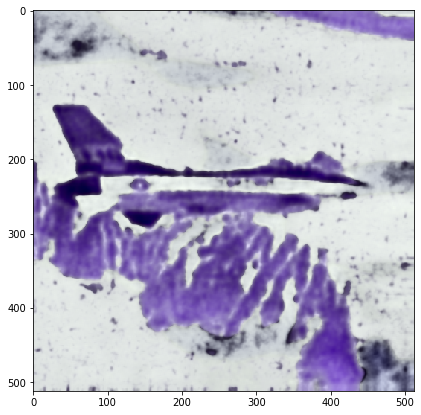

Iter # 180 , PSRN NOISY:  13.948805396426351 ; PSRN GT:  16.933997499686797


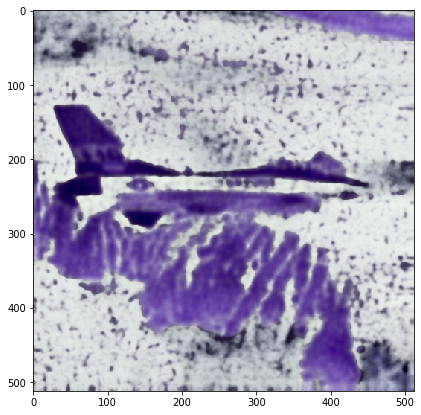

Iter # 190 , PSRN NOISY:  16.2157607970069 ; PSRN GT:  19.51540174758369


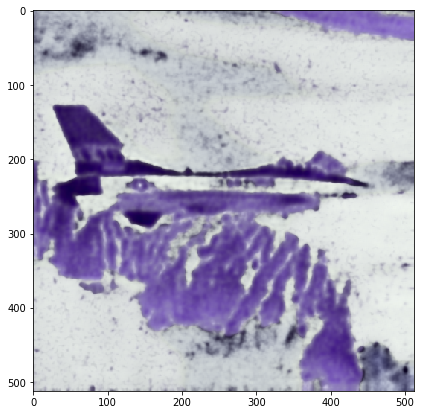

Iter # 200 , PSRN NOISY:  15.860796836909064 ; PSRN GT:  20.154066582842187


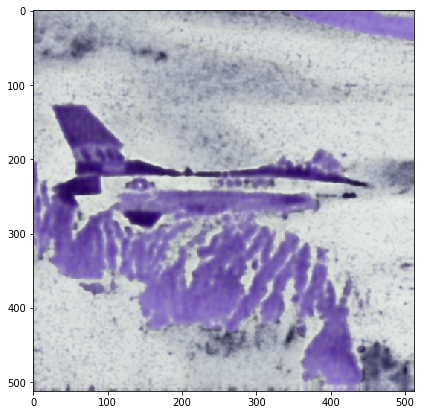

Iter # 210 , PSRN NOISY:  16.318140349227015 ; PSRN GT:  20.89216842113462


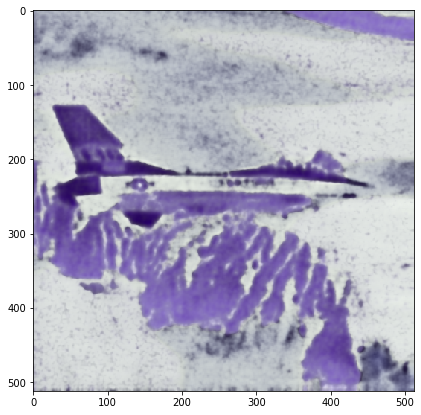

Iter # 220 , PSRN NOISY:  16.438190893096312 ; PSRN GT:  20.9096662260976


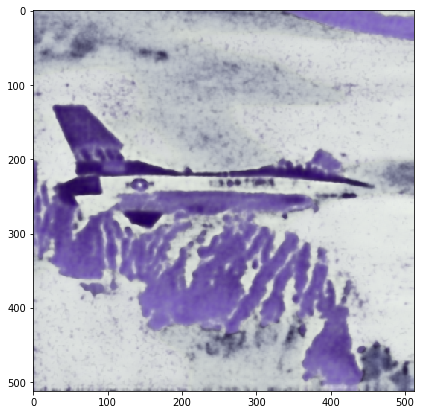

Iter # 230 , PSRN NOISY:  16.623679961997798 ; PSRN GT:  21.50143177815066


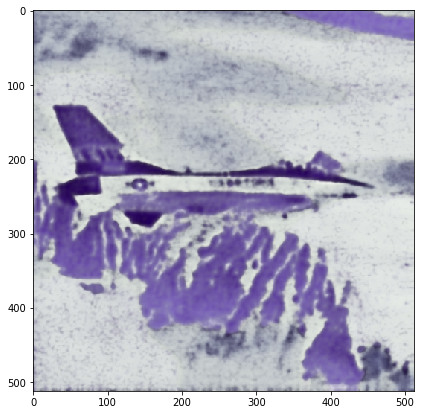

Iter # 240 , PSRN NOISY:  17.551202536939122 ; PSRN GT:  22.17575639767837


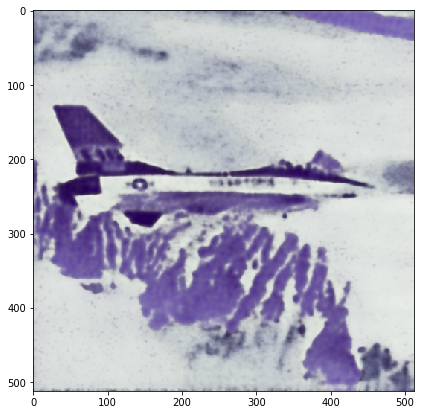

Iter # 250 , PSRN NOISY:  18.3686318324379 ; PSRN GT:  23.127727067499272


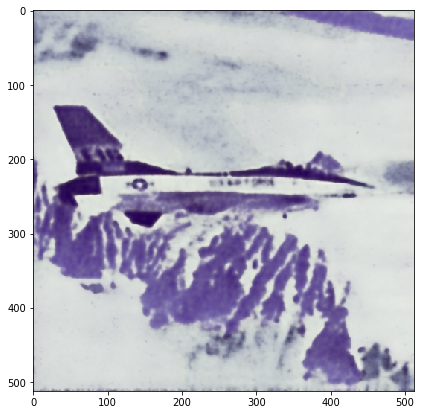

Iter # 260 , PSRN NOISY:  19.153382677464215 ; PSRN GT:  23.28835560104874


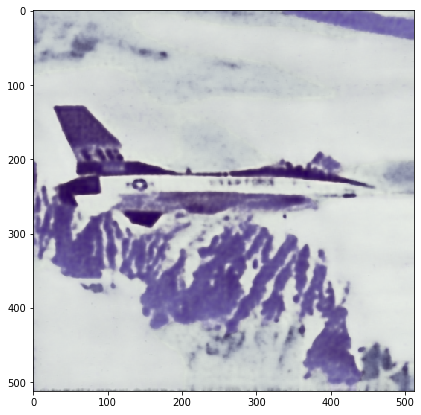

Iter # 270 , PSRN NOISY:  18.92745308442626 ; PSRN GT:  23.4483542745952


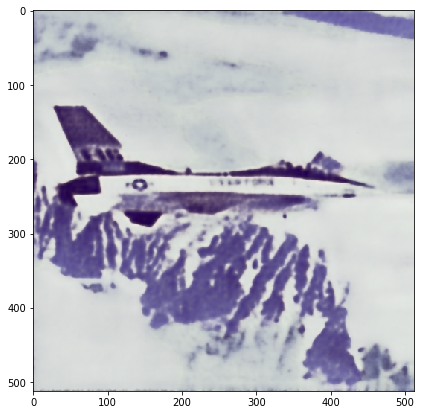

Iter # 280 , PSRN NOISY:  18.64071047477 ; PSRN GT:  23.674366479402032


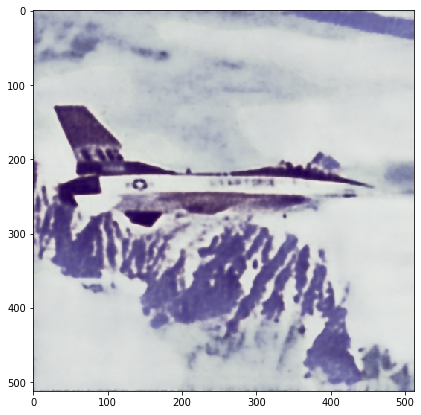

Iter # 290 , PSRN NOISY:  19.154956937054592 ; PSRN GT:  23.41850502554656


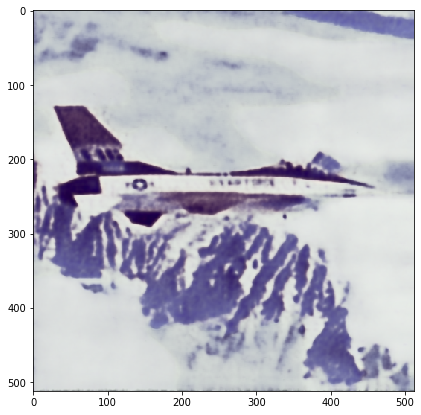

Iter # 300 , PSRN NOISY:  19.919433385031773 ; PSRN GT:  23.615084304760494


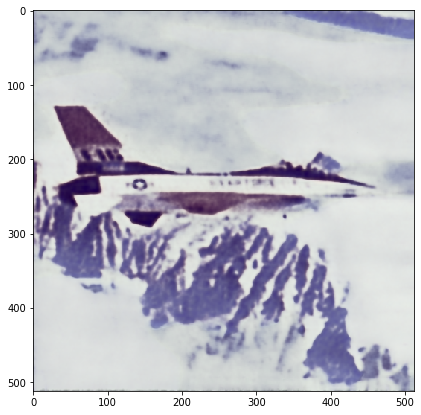

Iter # 310 , PSRN NOISY:  20.378004244990674 ; PSRN GT:  23.552757279644545


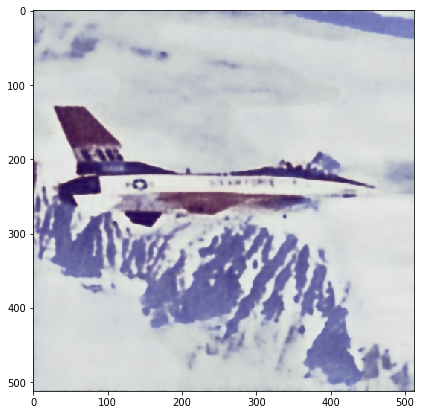

Iter # 320 , PSRN NOISY:  20.629245668195825 ; PSRN GT:  23.26536468141954


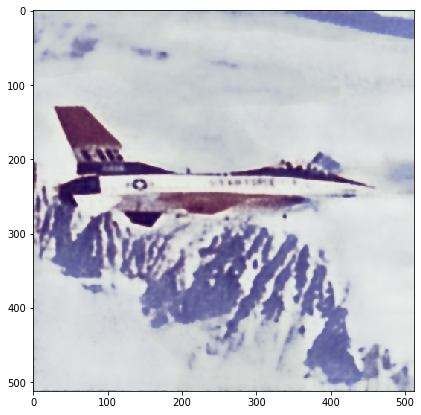

Iter # 330 , PSRN NOISY:  21.009047228755744 ; PSRN GT:  23.15325097479765


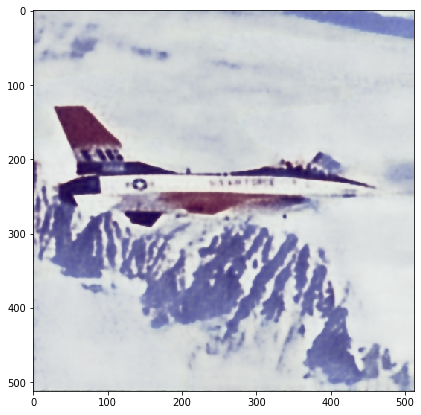

Iter # 340 , PSRN NOISY:  21.78060890801373 ; PSRN GT:  22.289927644599217


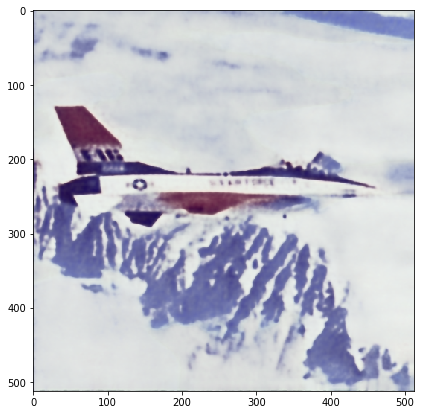

Iter # 350 , PSRN NOISY:  21.791350100838713 ; PSRN GT:  22.40161748971041


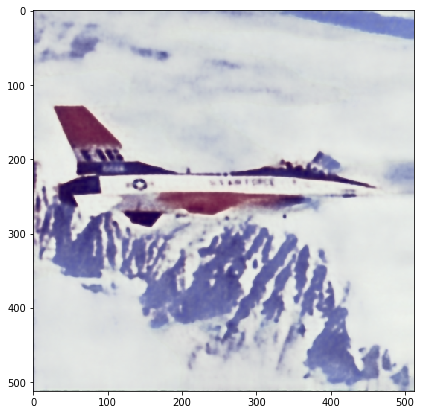

Iter # 360 , PSRN NOISY:  22.05114638887298 ; PSRN GT:  22.21615697368048


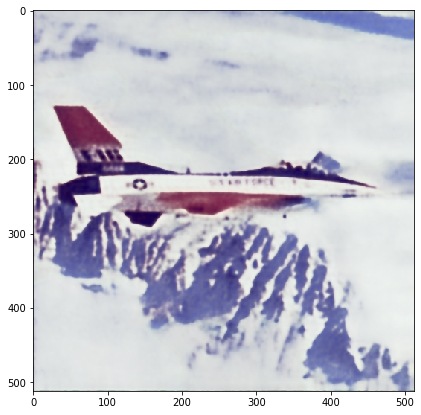

Iter # 370 , PSRN NOISY:  22.236256272527054 ; PSRN GT:  22.42323530497845


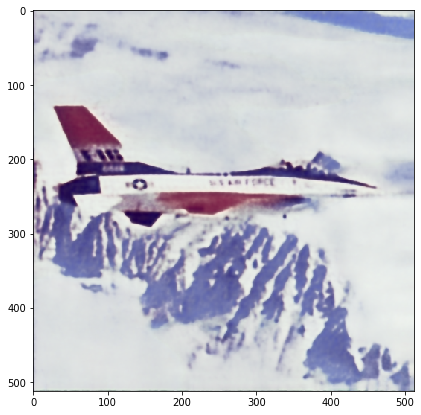

Iter # 380 , PSRN NOISY:  22.23014148774665 ; PSRN GT:  22.130117736391046


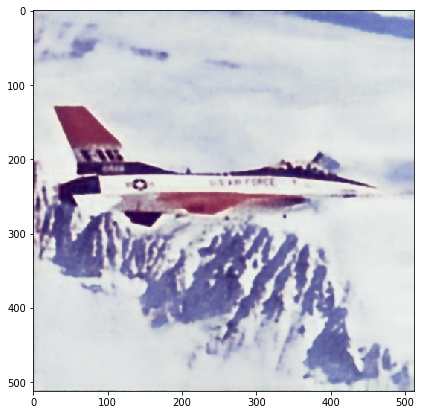

Iter # 390 , PSRN NOISY:  21.65640878753849 ; PSRN GT:  22.042617323406542


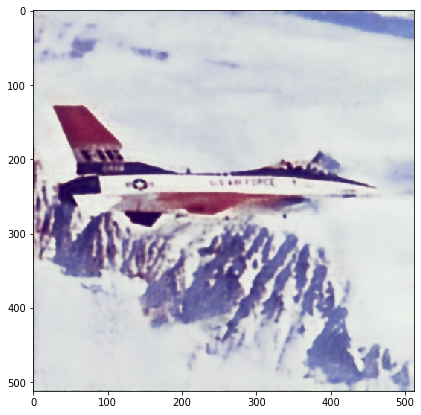

Iter # 400 , PSRN NOISY:  22.55893606524394 ; PSRN GT:  21.967848471170875


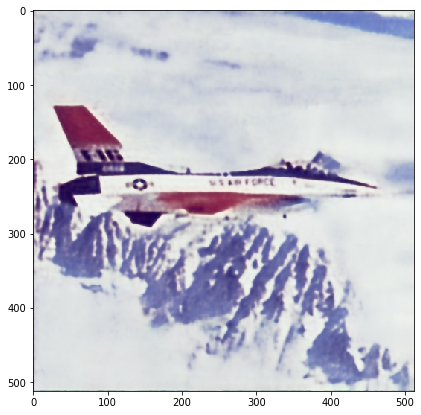

Iter # 410 , PSRN NOISY:  22.88099584724828 ; PSRN GT:  21.78498442802728


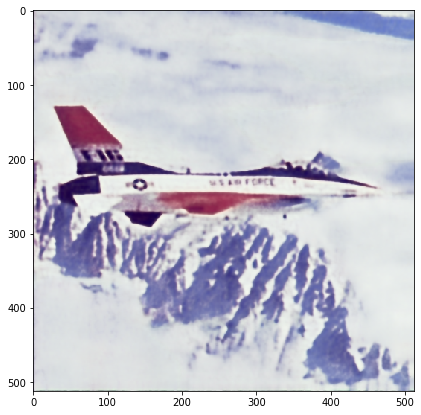

Iter # 420 , PSRN NOISY:  22.836982379406262 ; PSRN GT:  21.556034561745776


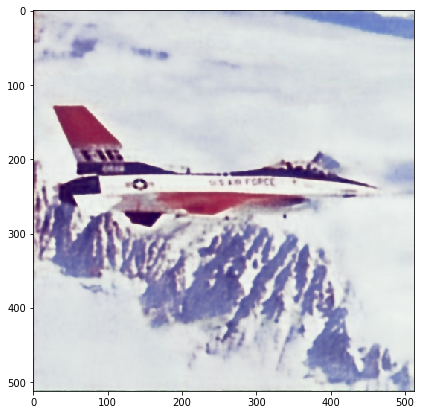

Iter # 430 , PSRN NOISY:  22.8988162057996 ; PSRN GT:  21.469910218075363


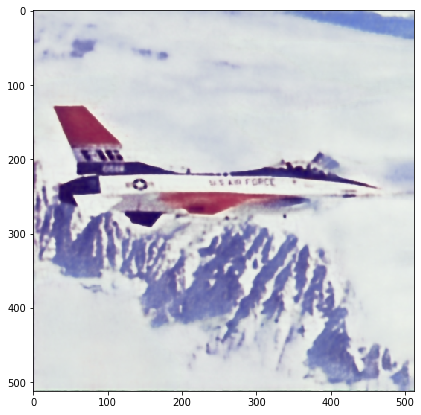

Iter # 440 , PSRN NOISY:  23.11017494663437 ; PSRN GT:  21.657677776839733


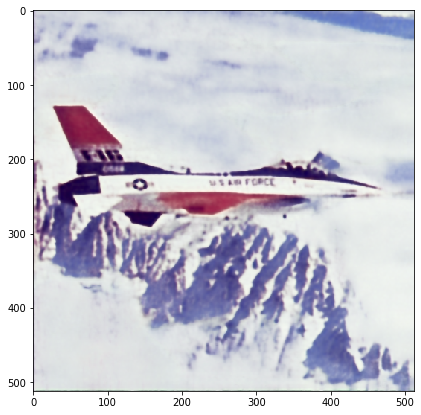

Iter # 450 , PSRN NOISY:  23.196643295549343 ; PSRN GT:  21.36756918515179


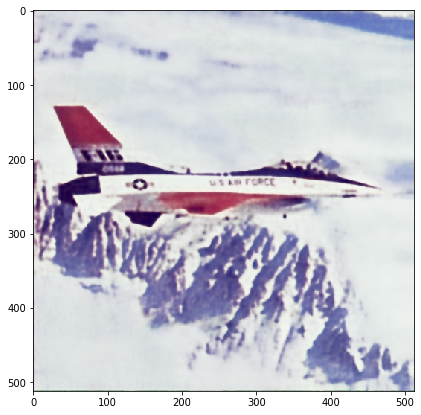

Iter # 460 , PSRN NOISY:  23.47678607163936 ; PSRN GT:  21.06688852191646


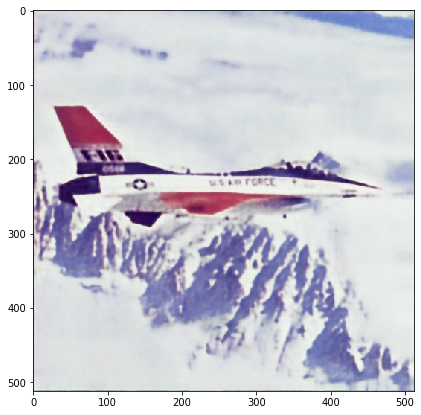

Iter # 470 , PSRN NOISY:  23.629896452963692 ; PSRN GT:  20.873737045351763


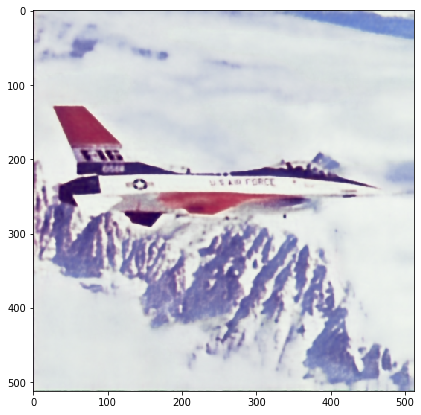

Iter # 480 , PSRN NOISY:  23.497063529178263 ; PSRN GT:  20.3193709182092


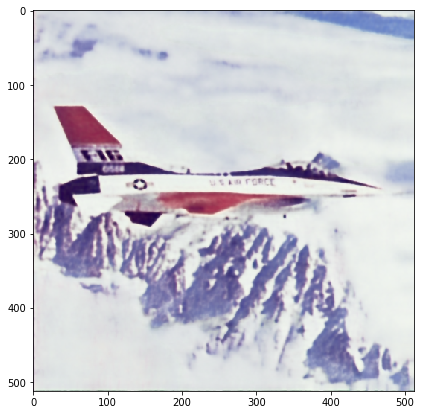

Iter # 490 , PSRN NOISY:  23.74095382272399 ; PSRN GT:  20.609079595839248


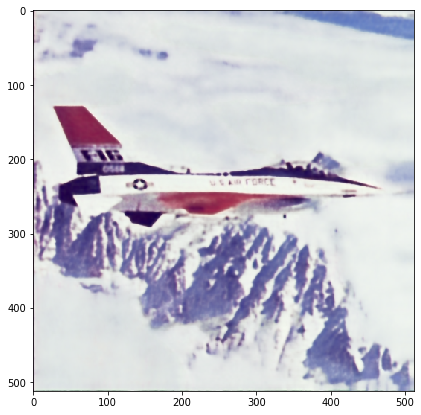

Iter # 500 , PSRN NOISY:  23.803002890487267 ; PSRN GT:  20.79766421636783


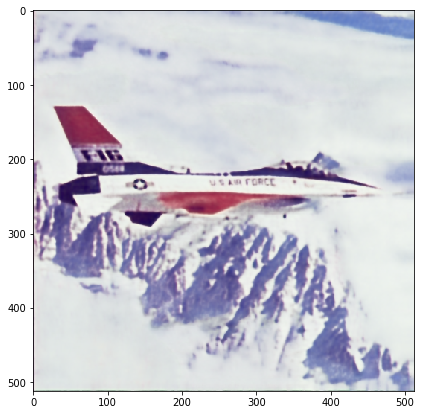

Iter # 510 , PSRN NOISY:  23.6905929974128 ; PSRN GT:  20.018632870173512


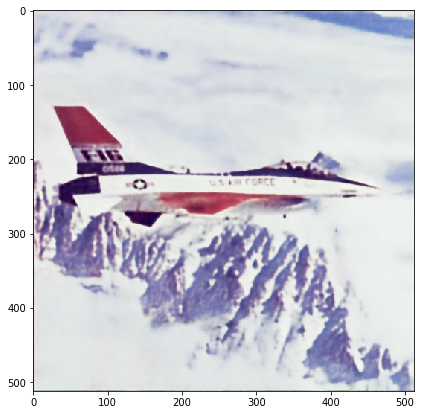

Iter # 520 , PSRN NOISY:  23.564209087225937 ; PSRN GT:  20.435079503023637


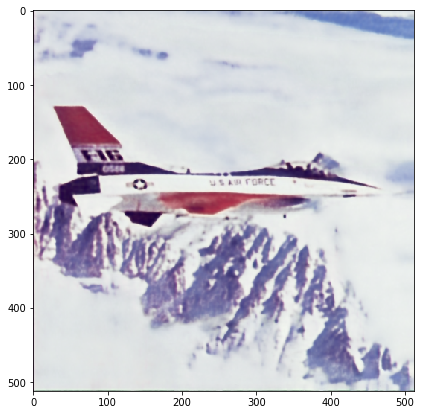

Iter # 530 , PSRN NOISY:  23.894259322327848 ; PSRN GT:  20.637544143545355


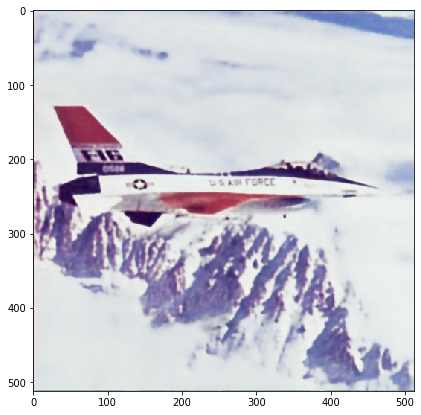

Iter # 540 , PSRN NOISY:  23.736569695657217 ; PSRN GT:  20.358792201857824


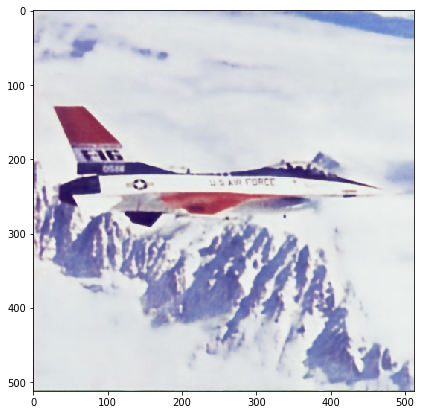

Iter # 550 , PSRN NOISY:  24.09663465402182 ; PSRN GT:  20.17409421919028


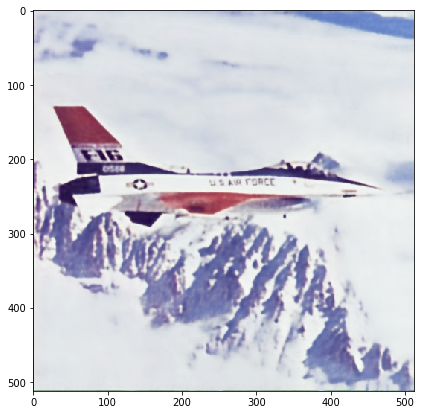

Iter # 560 , PSRN NOISY:  24.12205242194071 ; PSRN GT:  20.107002758532616


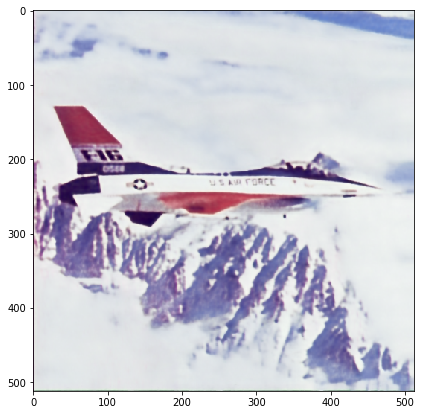

Iter # 570 , PSRN NOISY:  23.802503286432966 ; PSRN GT:  20.153766615362446


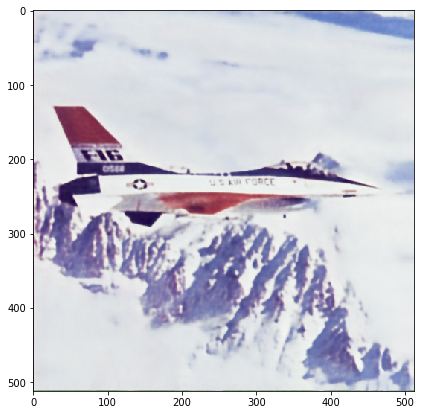

Iter # 580 , PSRN NOISY:  24.393001714171547 ; PSRN GT:  20.123646046287217


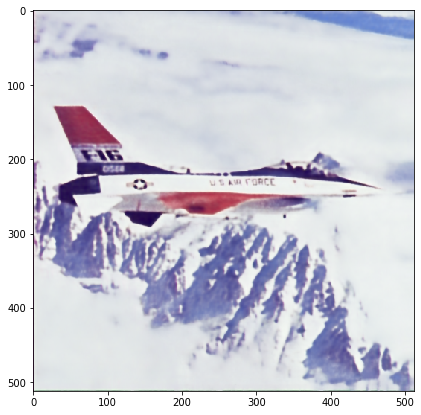

Iter # 590 , PSRN NOISY:  24.39214959957461 ; PSRN GT:  19.998820676655654


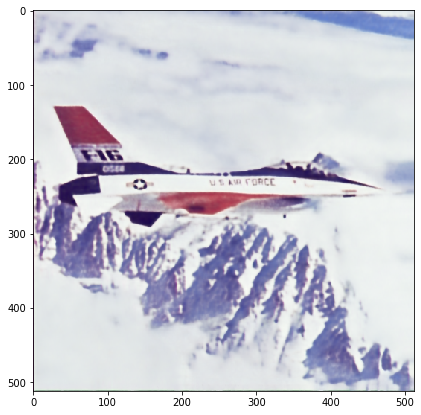

Iter # 600 , PSRN NOISY:  24.425038252301686 ; PSRN GT:  20.44513211960922


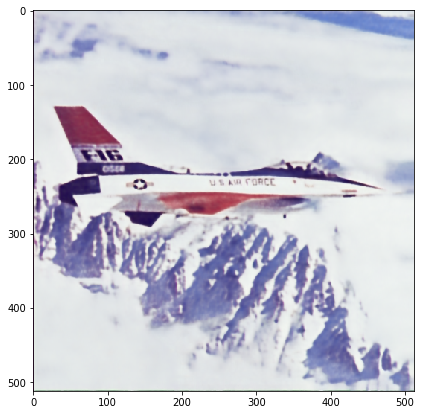

Iter # 610 , PSRN NOISY:  23.5382444402153 ; PSRN GT:  20.374082438591934


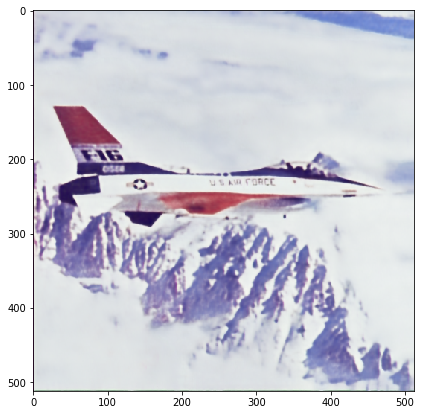

Iter # 620 , PSRN NOISY:  24.338026032739037 ; PSRN GT:  20.517501133166327


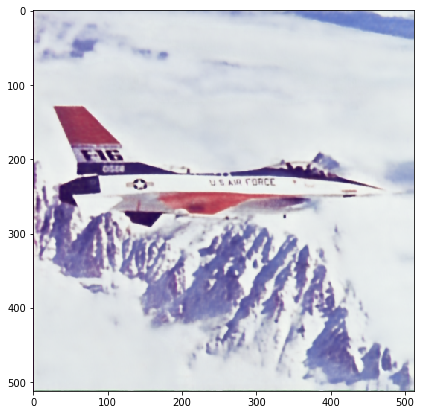

Iter # 630 , PSRN NOISY:  24.402126699161965 ; PSRN GT:  20.71480877712029


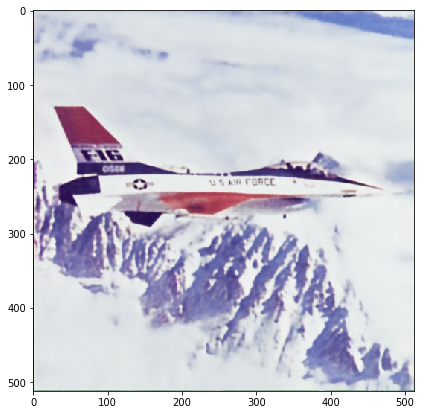

Iter # 640 , PSRN NOISY:  24.573431016631947 ; PSRN GT:  20.793643965353677


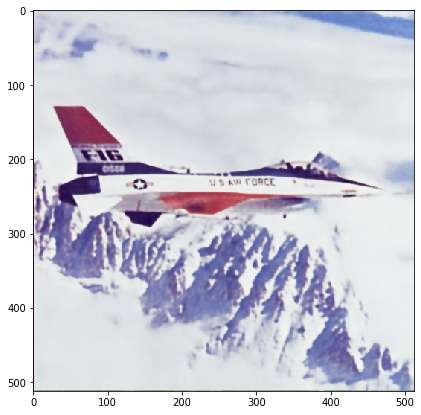

Iter # 650 , PSRN NOISY:  24.6044313333936 ; PSRN GT:  20.66612190449461


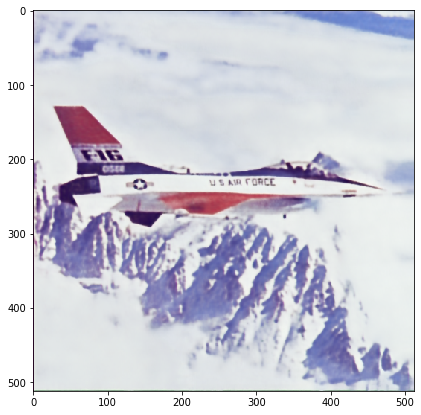

Iter # 660 , PSRN NOISY:  24.858363973246476 ; PSRN GT:  20.719763138701772


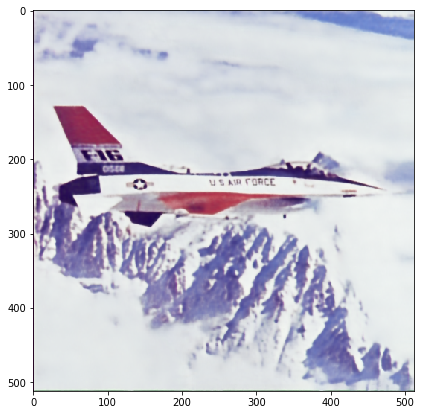

Iter # 670 , PSRN NOISY:  24.905583817402484 ; PSRN GT:  20.608549986555758


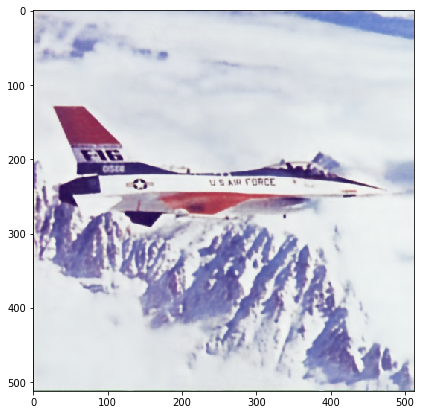

Iter # 680 , PSRN NOISY:  24.364087454438188 ; PSRN GT:  20.437534807276656


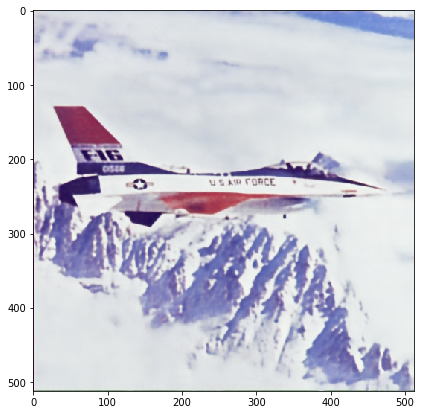

Iter # 690 , PSRN NOISY:  25.438411675106686 ; PSRN GT:  20.807743864867234


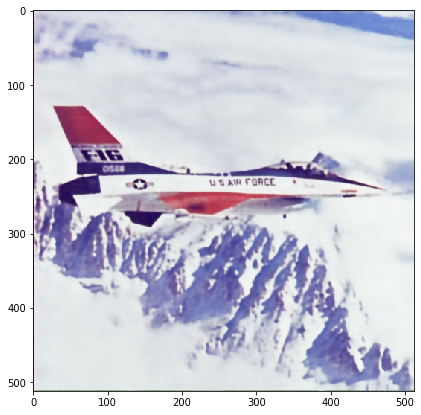

Iter # 700 , PSRN NOISY:  25.48074377880994 ; PSRN GT:  20.18730400861765


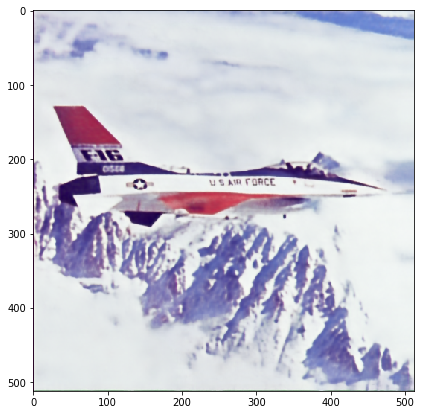

Iter # 710 , PSRN NOISY:  25.45653512622952 ; PSRN GT:  20.290835430804304


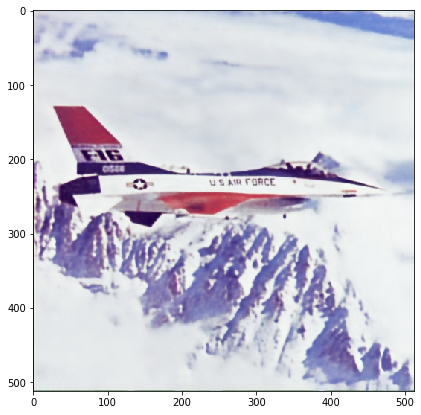

Iter # 720 , PSRN NOISY:  25.385515101255272 ; PSRN GT:  20.5199938726657


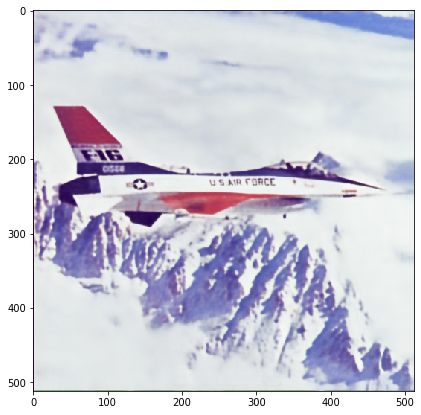

Iter # 730 , PSRN NOISY:  25.81205740821328 ; PSRN GT:  20.437434370954858


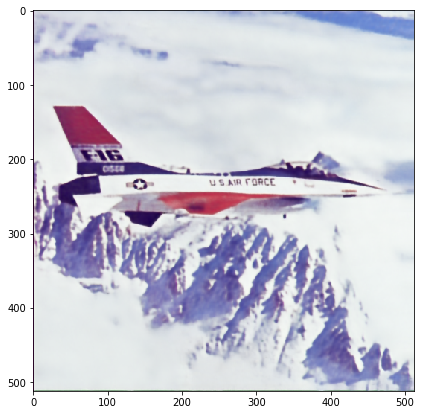

Iter # 740 , PSRN NOISY:  25.52029734923113 ; PSRN GT:  20.50884685580599


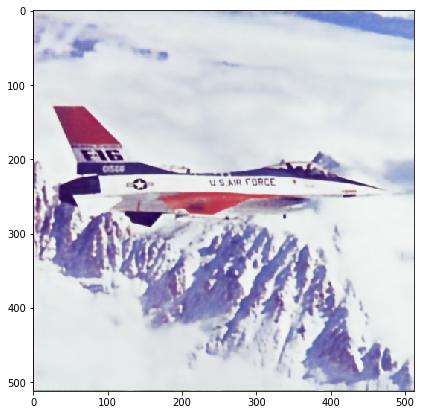

Iter # 750 , PSRN NOISY:  25.500768454593615 ; PSRN GT:  20.56230829399261


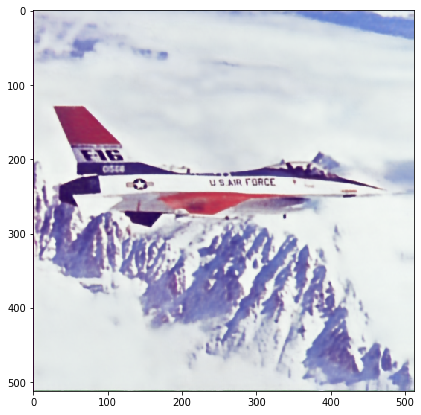

Iter # 760 , PSRN NOISY:  25.748471673309822 ; PSRN GT:  20.491038874680193


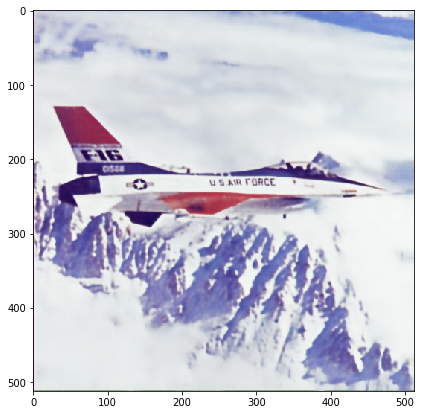

Iter # 770 , PSRN NOISY:  25.864012164927534 ; PSRN GT:  20.001131774906046


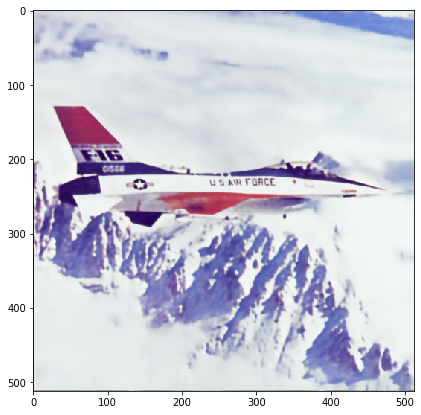

Iter # 780 , PSRN NOISY:  25.936400742772886 ; PSRN GT:  19.952937531358906


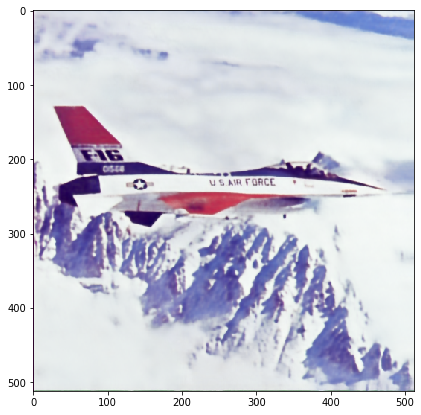

Iter # 790 , PSRN NOISY:  25.830199701622924 ; PSRN GT:  20.05246394979271


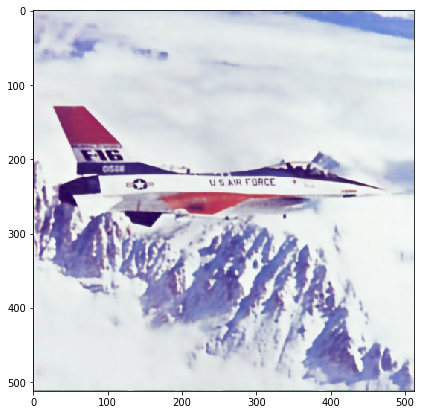

Iter # 800 , PSRN NOISY:  26.139800946653192 ; PSRN GT:  20.19097249331179


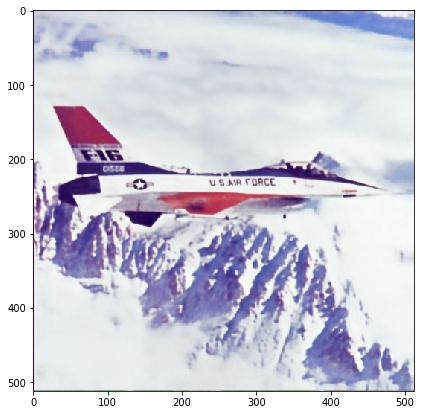

Iter # 810 , PSRN NOISY:  25.97566059567871 ; PSRN GT:  20.415761958859903


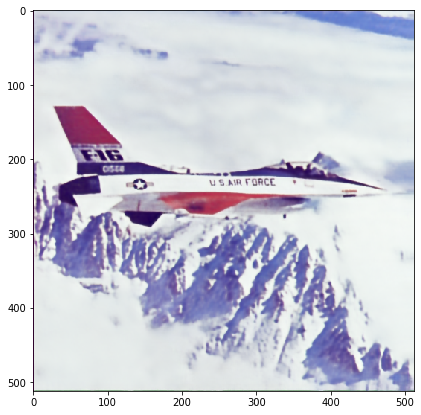

Iter # 820 , PSRN NOISY:  26.046102974121055 ; PSRN GT:  20.443468625040644


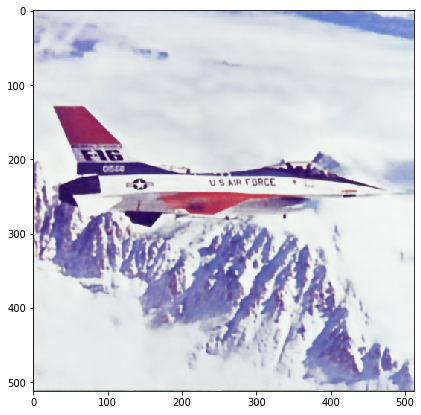

Iter # 830 , PSRN NOISY:  25.981545003475812 ; PSRN GT:  20.12579807034108


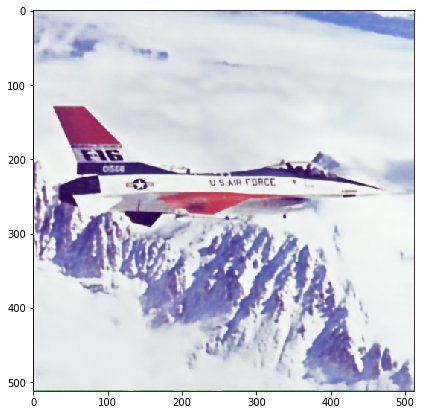

Iter # 840 , PSRN NOISY:  25.67287625034187 ; PSRN GT:  20.266783419710997


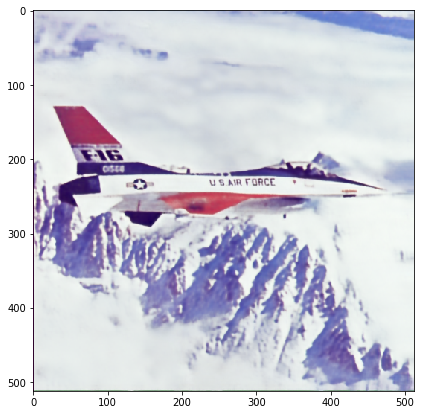

Iter # 850 , PSRN NOISY:  26.17360133629267 ; PSRN GT:  20.073070680483998


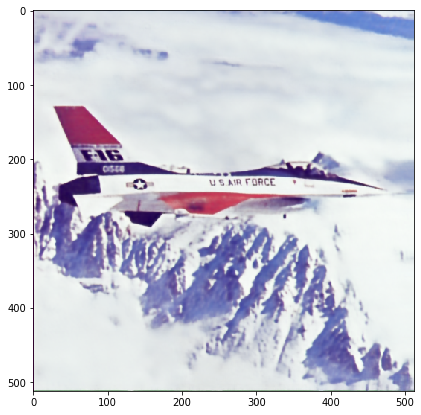

Iter # 860 , PSRN NOISY:  25.824823294283007 ; PSRN GT:  20.617613960361748


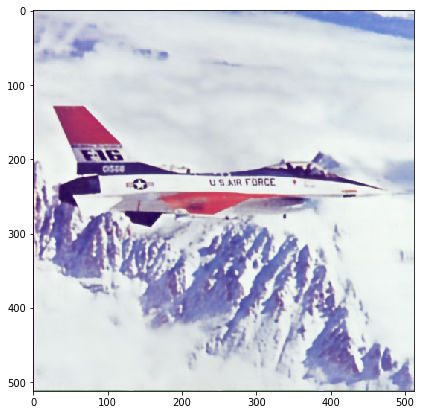

Iter # 870 , PSRN NOISY:  26.296893178320452 ; PSRN GT:  20.353078153853872


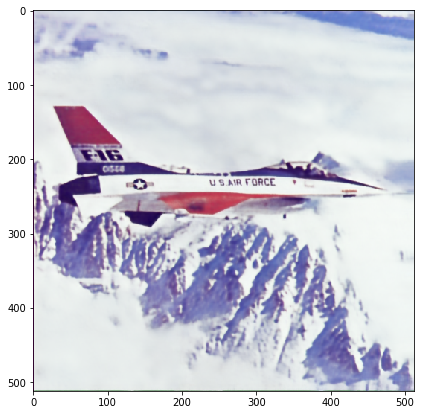

Iter # 880 , PSRN NOISY:  26.197020780215297 ; PSRN GT:  20.637550821866455


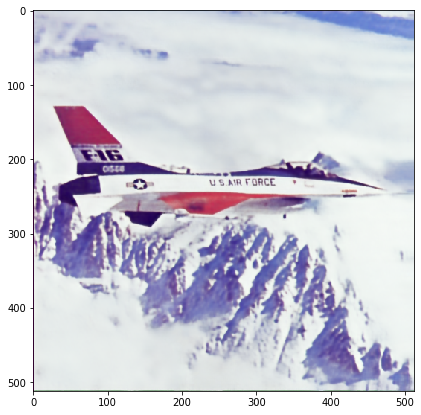

Iter # 890 , PSRN NOISY:  26.331344724897725 ; PSRN GT:  20.5487843632273


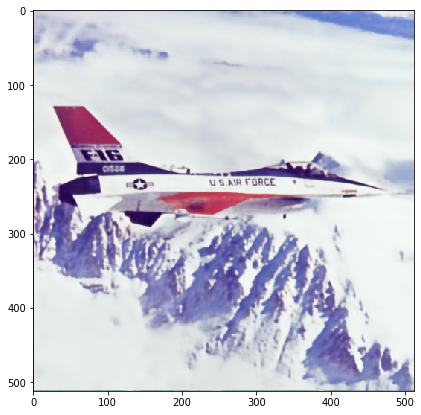

Iter # 900 , PSRN NOISY:  26.210695090089967 ; PSRN GT:  20.471487249985895


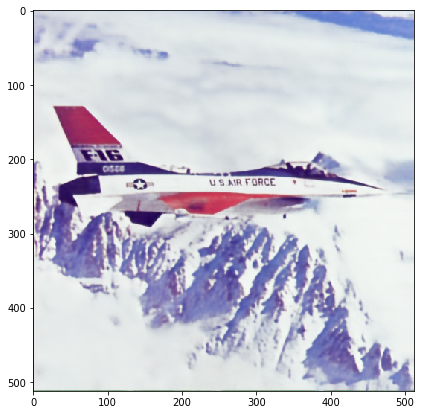

Iter # 910 , PSRN NOISY:  26.410074321681606 ; PSRN GT:  20.51135414040293


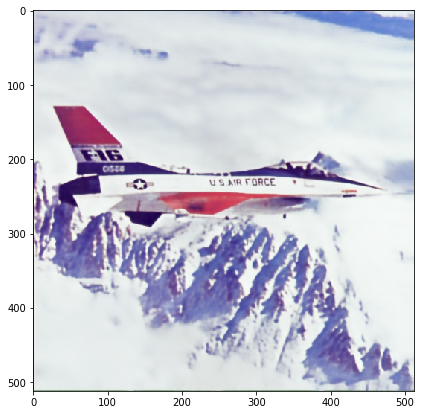

Iter # 920 , PSRN NOISY:  26.36305606102988 ; PSRN GT:  20.64660776834089


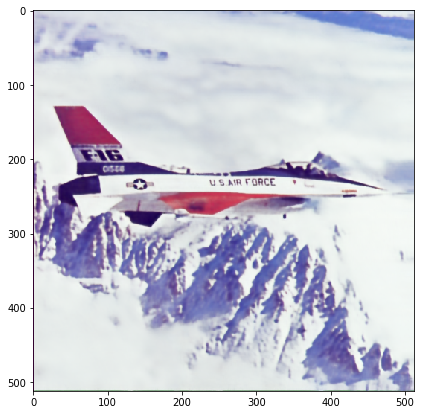

Iter # 930 , PSRN NOISY:  26.498400008562335 ; PSRN GT:  20.391726477316524


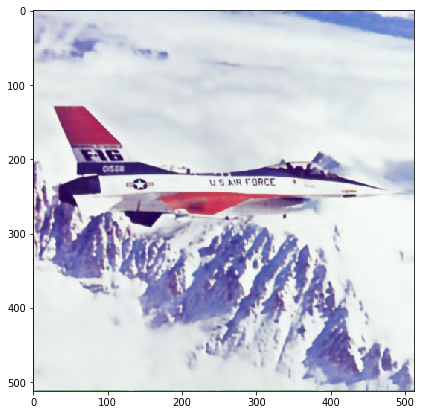

Iter # 940 , PSRN NOISY:  26.441508017837947 ; PSRN GT:  20.584879382809472


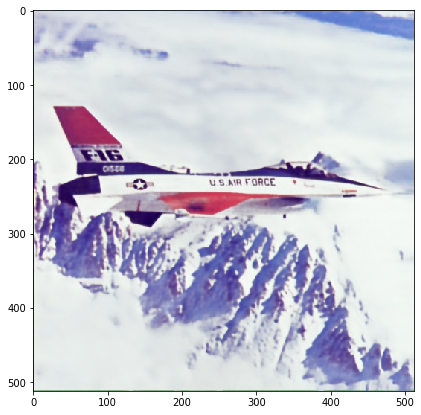

Iter # 950 , PSRN NOISY:  26.459870767719234 ; PSRN GT:  20.314334959499757


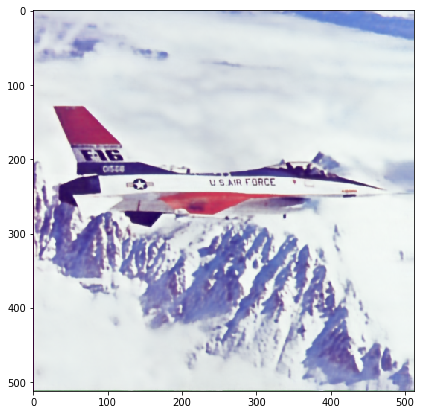

Iter # 960 , PSRN NOISY:  26.258240038868564 ; PSRN GT:  20.48945970248516


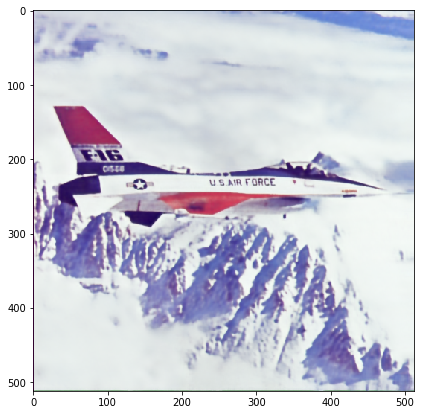

Iter # 970 , PSRN NOISY:  26.41281018444783 ; PSRN GT:  20.52562067746432


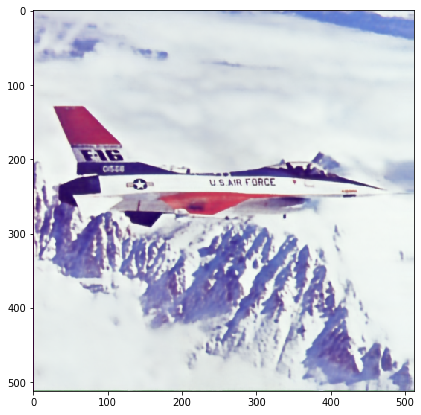

Iter # 980 , PSRN NOISY:  26.500340911066246 ; PSRN GT:  20.36604536650234


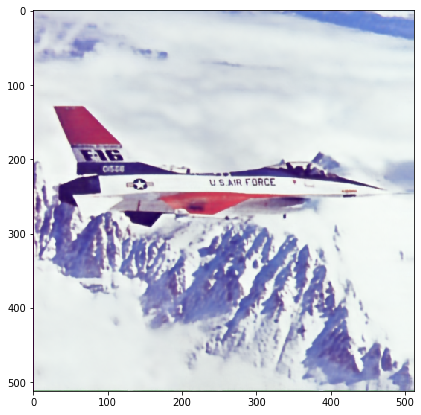

Iter # 990 , PSRN NOISY:  26.420515501767635 ; PSRN GT:  20.29922820727962


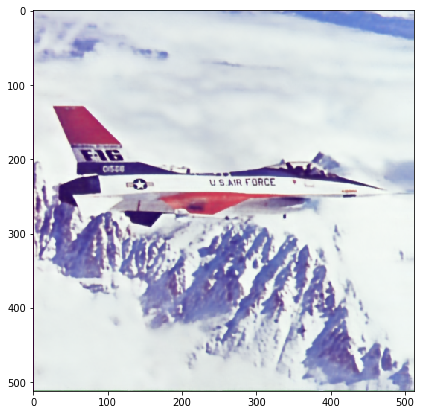

Iter # 1000 , PSRN NOISY:  26.590171901109677 ; PSRN GT:  20.122123724232836


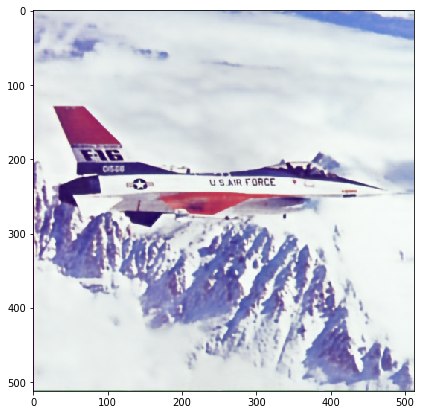

Iter # 1010 , PSRN NOISY:  26.639608184063107 ; PSRN GT:  20.232218258296818


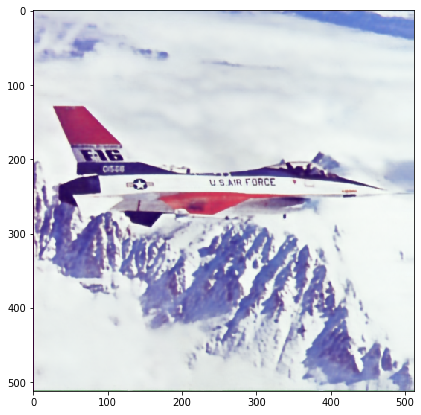

Iter # 1020 , PSRN NOISY:  26.545064338055443 ; PSRN GT:  20.371317468436413


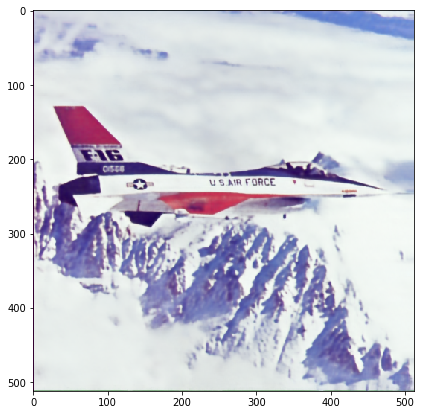

Iter # 1030 , PSRN NOISY:  26.4942177151808 ; PSRN GT:  20.482627935903217


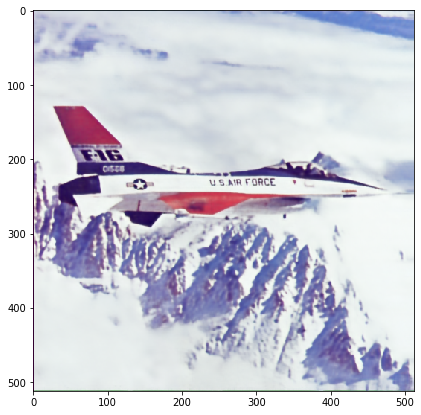

Iter # 1040 , PSRN NOISY:  26.397911889869846 ; PSRN GT:  20.221672731551422


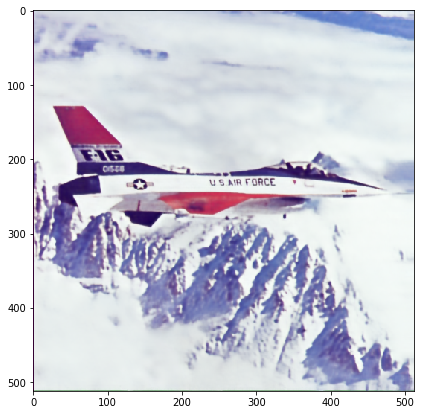

Iter # 1050 , PSRN NOISY:  26.639990387417086 ; PSRN GT:  20.29293129628593


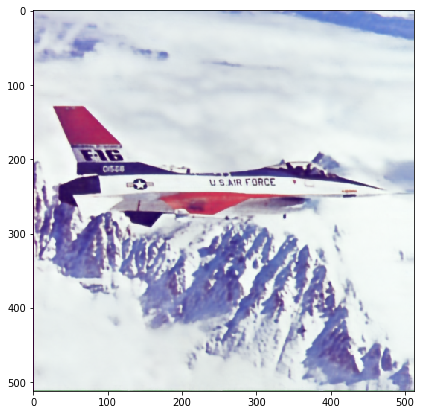

Iter # 1060 , PSRN NOISY:  26.566181692934553 ; PSRN GT:  20.26869493379587


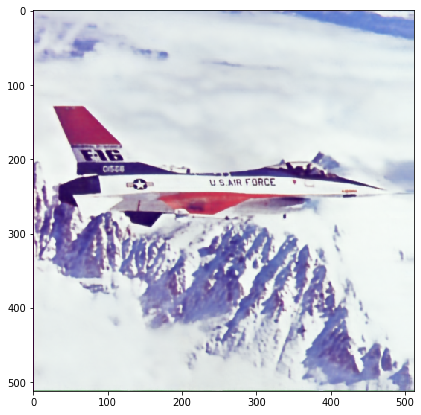

Iter # 1070 , PSRN NOISY:  26.341565410026444 ; PSRN GT:  20.81709980744548


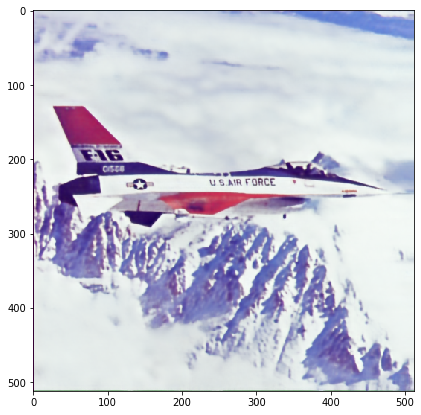

Iter # 1080 , PSRN NOISY:  26.455119749843785 ; PSRN GT:  20.468211688371444


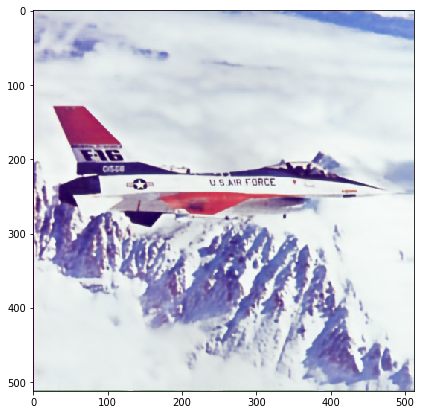

Iter # 1090 , PSRN NOISY:  26.441927004142393 ; PSRN GT:  20.507360225100754


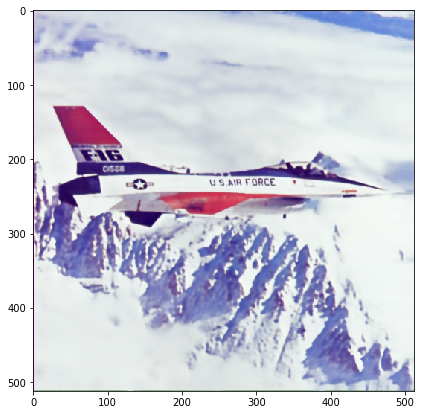

Iter # 1100 , PSRN NOISY:  26.51306112096941 ; PSRN GT:  20.842596915540806


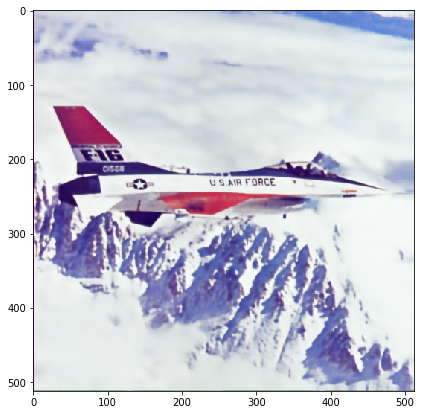

Iter # 1110 , PSRN NOISY:  26.667786823177693 ; PSRN GT:  20.43511480022999


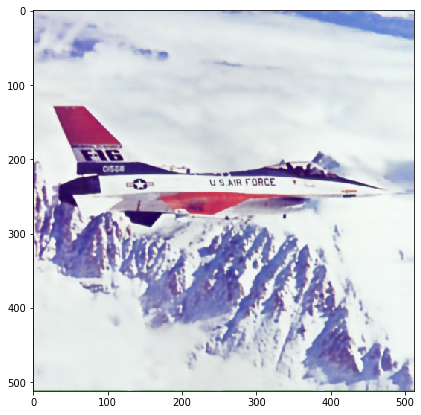

Iter # 1120 , PSRN NOISY:  26.429149388900036 ; PSRN GT:  20.707452538805665


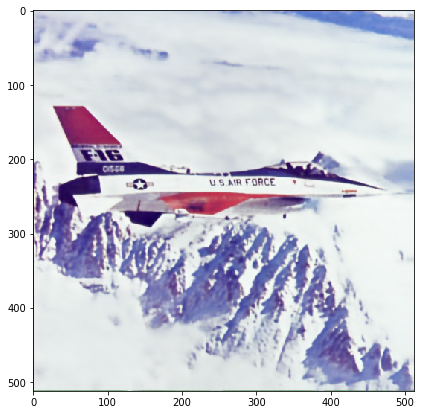

Iter # 1130 , PSRN NOISY:  26.590511198902746 ; PSRN GT:  20.54535422273237


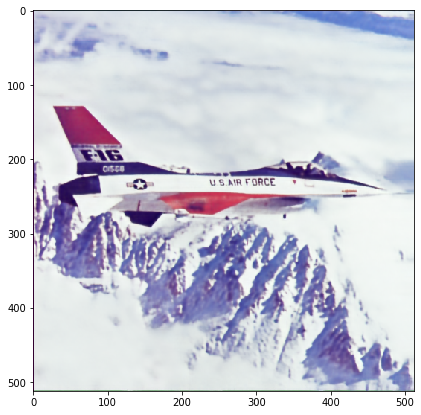

Iter # 1140 , PSRN NOISY:  26.694585673338132 ; PSRN GT:  20.56518409180694


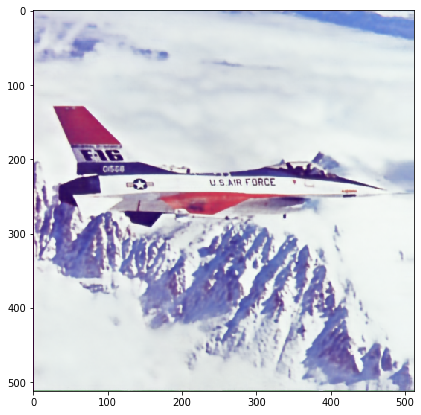

Iter # 1150 , PSRN NOISY:  26.579980157729267 ; PSRN GT:  20.742543764595005


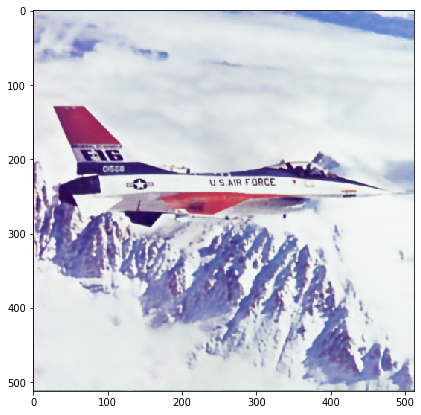

Iter # 1160 , PSRN NOISY:  26.501895479892333 ; PSRN GT:  20.790878682871863


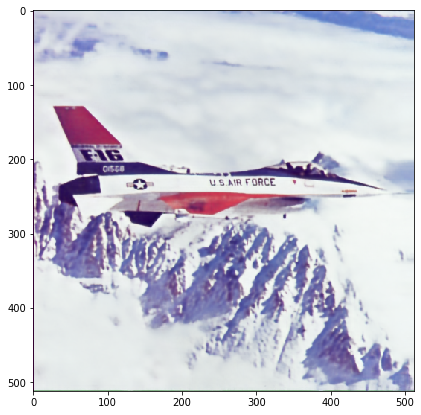

Iter # 1170 , PSRN NOISY:  26.541631972902064 ; PSRN GT:  20.819778172774704


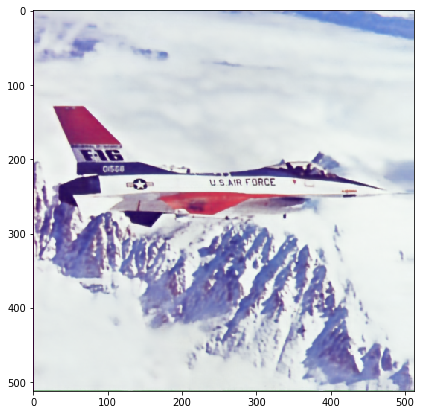

Iter # 1180 , PSRN NOISY:  26.61991595521124 ; PSRN GT:  20.68494333916734


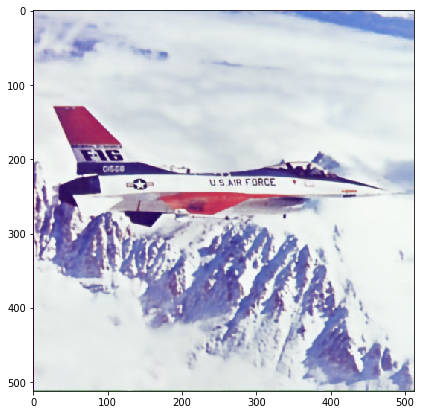

Iter # 1190 , PSRN NOISY:  26.819928379531927 ; PSRN GT:  20.199505097231388


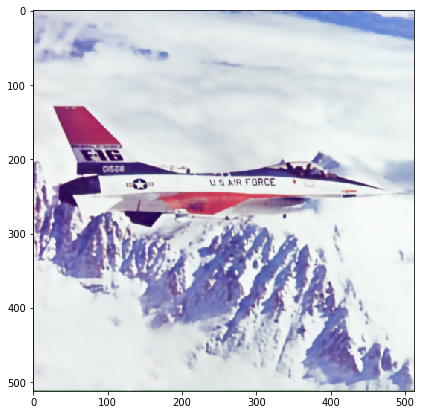

Iter # 1200 , PSRN NOISY:  26.820052928943056 ; PSRN GT:  20.17810687696395


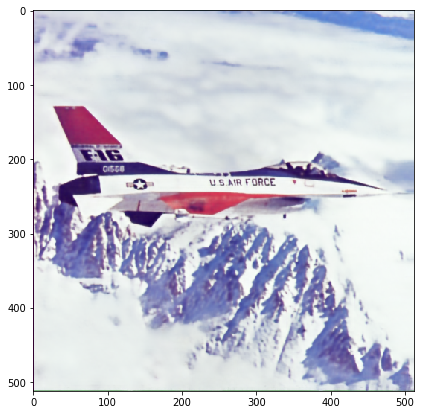

Iter # 1210 , PSRN NOISY:  26.804272289474042 ; PSRN GT:  20.415280842279614


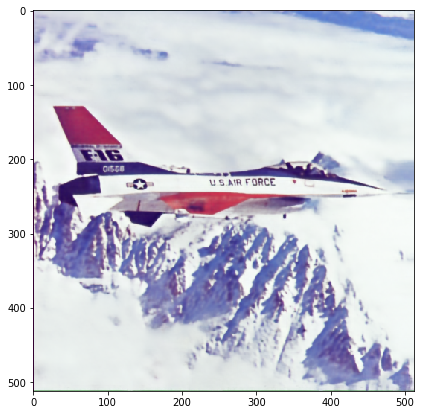

Iter # 1220 , PSRN NOISY:  26.788968568305837 ; PSRN GT:  20.24526066942134


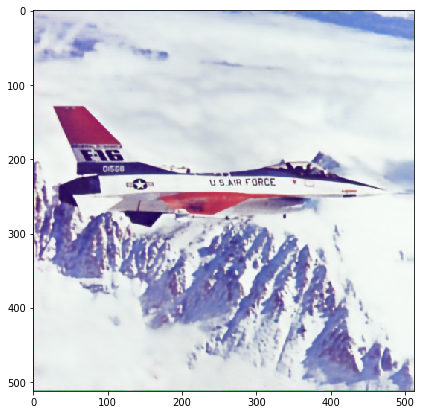

Iter # 1230 , PSRN NOISY:  26.859848764001345 ; PSRN GT:  20.309898392491277


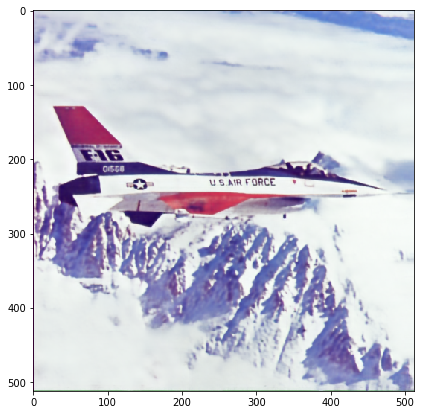

Iter # 1240 , PSRN NOISY:  26.64802141530004 ; PSRN GT:  20.554755055747034


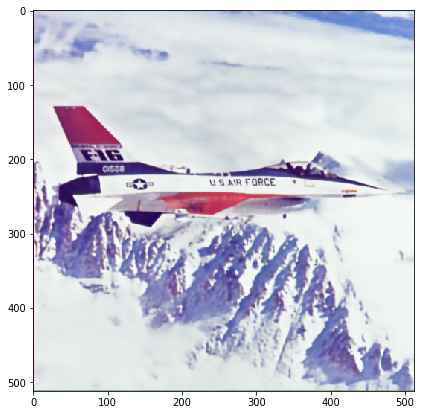

Iter # 1250 , PSRN NOISY:  26.784984396087083 ; PSRN GT:  20.763954207484563


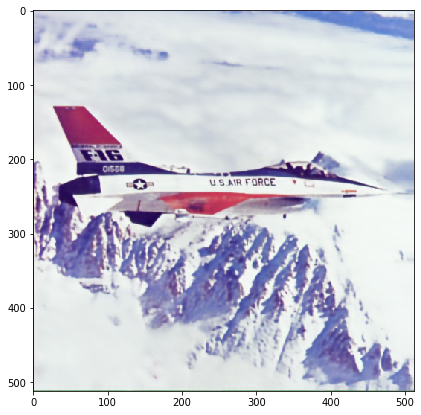

Iter # 1260 , PSRN NOISY:  26.692483998210555 ; PSRN GT:  20.50744568289


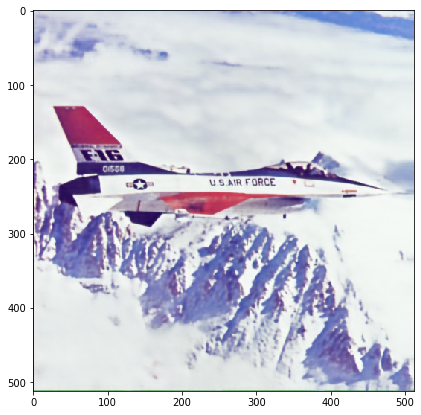

Iter # 1270 , PSRN NOISY:  26.80295508208158 ; PSRN GT:  20.333213450873032


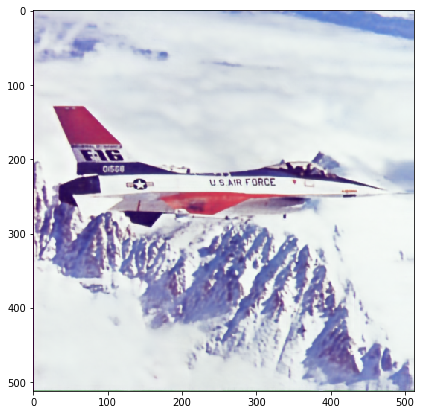

Iter # 1280 , PSRN NOISY:  26.815776925661293 ; PSRN GT:  20.463702828760503


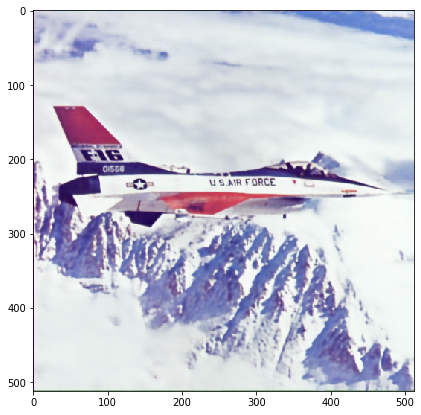

Iter # 1290 , PSRN NOISY:  26.890819335107853 ; PSRN GT:  20.195947582262068


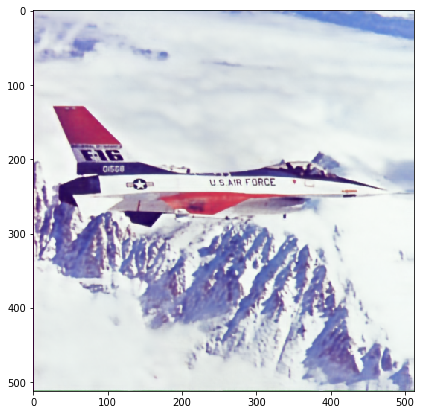

Iter # 1300 , PSRN NOISY:  26.877465066773393 ; PSRN GT:  20.381123475391206


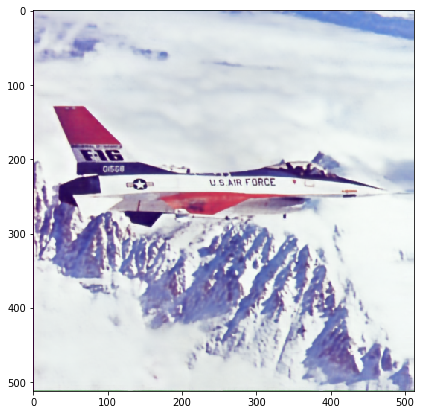

Iter # 1310 , PSRN NOISY:  26.883056811629164 ; PSRN GT:  20.315030894396973


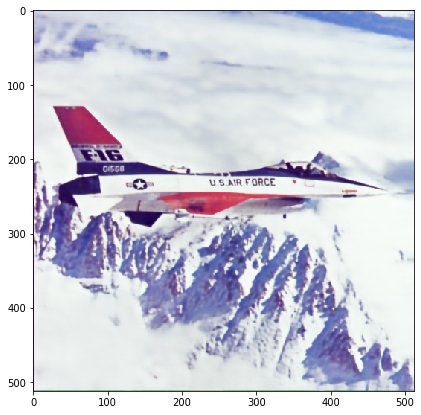

Iter # 1320 , PSRN NOISY:  26.904452414180035 ; PSRN GT:  20.37833622092748


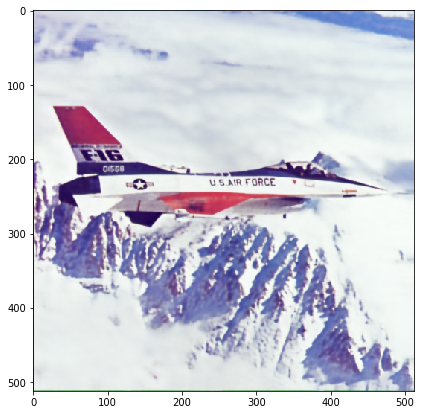

Iter # 1330 , PSRN NOISY:  26.90047990136277 ; PSRN GT:  20.35459965068574


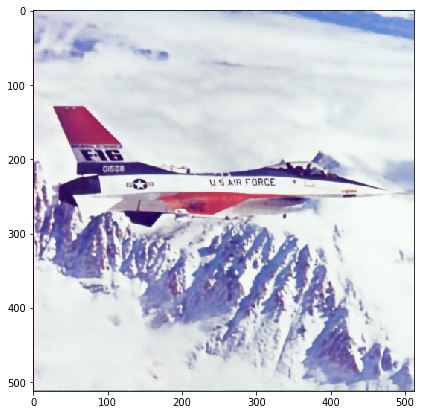

Iter # 1340 , PSRN NOISY:  26.70469829052569 ; PSRN GT:  20.450652413959737


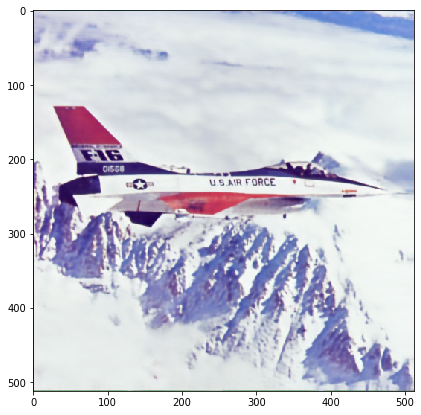

Iter # 1350 , PSRN NOISY:  26.974072037178885 ; PSRN GT:  20.283776109523263


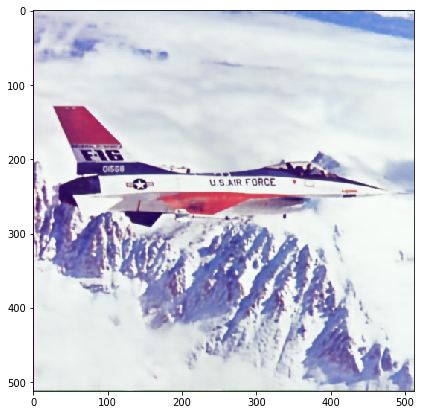

Iter # 1360 , PSRN NOISY:  26.877064941717226 ; PSRN GT:  20.57291367660386


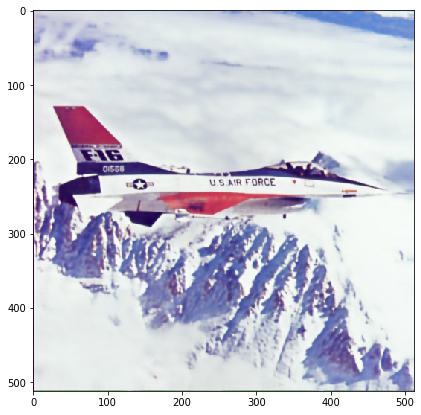

Iter # 1370 , PSRN NOISY:  27.041788018058163 ; PSRN GT:  20.07329139798123


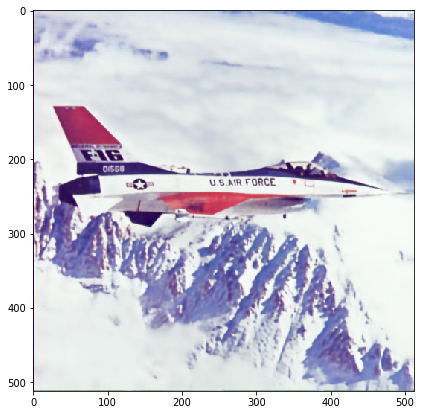

Iter # 1380 , PSRN NOISY:  26.857855408010337 ; PSRN GT:  20.599762008528554


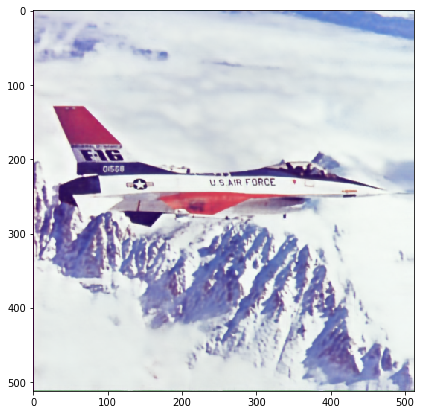

Iter # 1390 , PSRN NOISY:  26.971744050799856 ; PSRN GT:  20.41241594660619


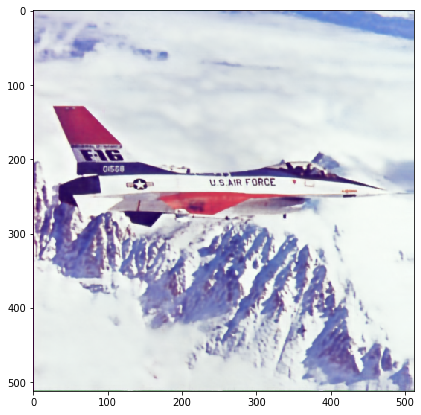

Iter # 1400 , PSRN NOISY:  26.823246002552537 ; PSRN GT:  20.413082217415784


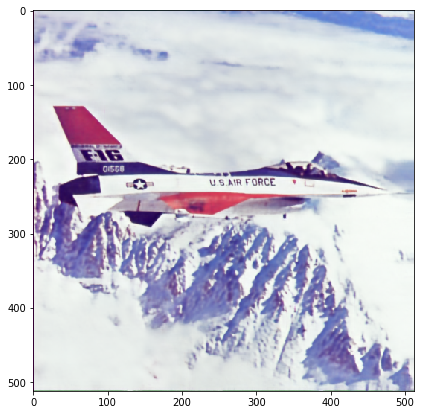

Iter # 1410 , PSRN NOISY:  27.04177809071444 ; PSRN GT:  20.224423973145772


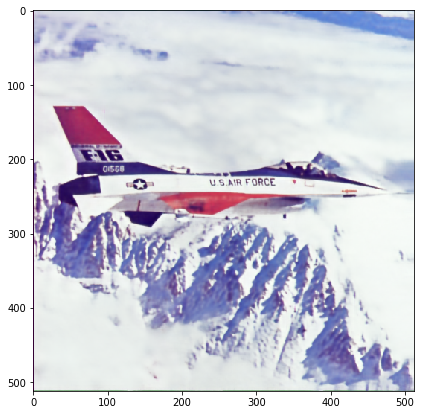

Iter # 1420 , PSRN NOISY:  26.988590731884997 ; PSRN GT:  20.57855380576406


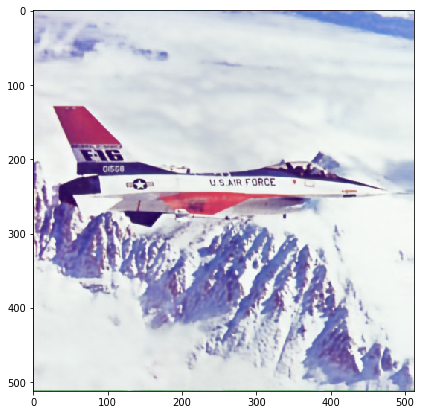

Iter # 1430 , PSRN NOISY:  27.000137445306763 ; PSRN GT:  20.518899908001636


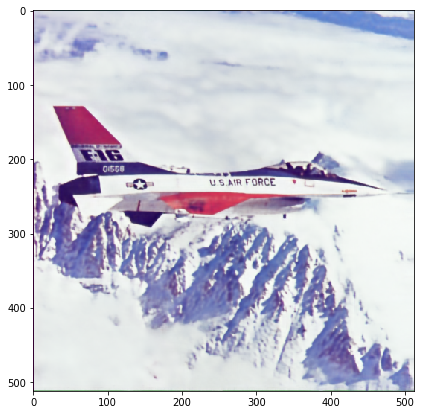

Iter # 1440 , PSRN NOISY:  26.873326691956642 ; PSRN GT:  20.64677243673744


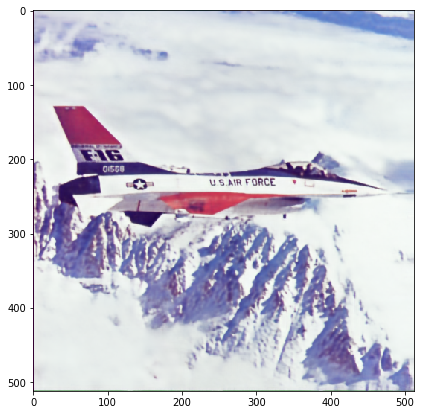

Iter # 1450 , PSRN NOISY:  26.88881578235177 ; PSRN GT:  20.757243594398535


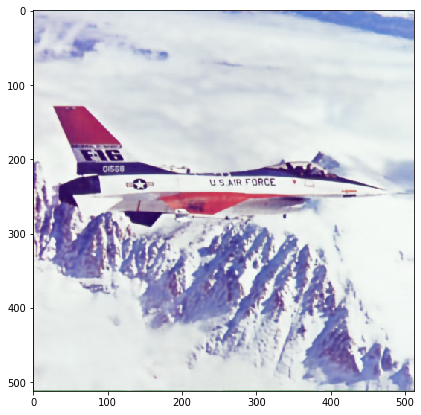

Iter # 1460 , PSRN NOISY:  27.005591919418546 ; PSRN GT:  20.439810655784378


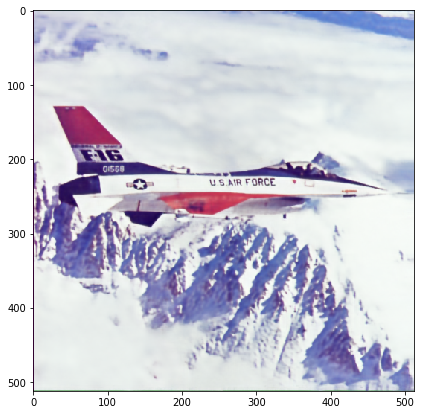

Iter # 1470 , PSRN NOISY:  26.966622822689427 ; PSRN GT:  20.402945182366842


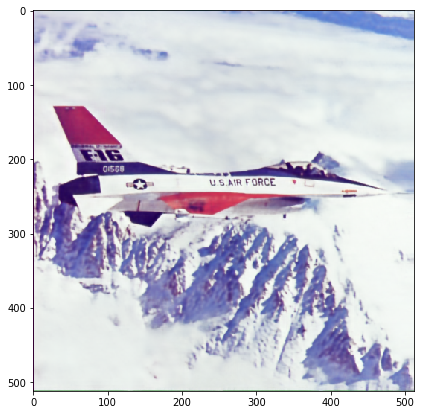

Iter # 1480 , PSRN NOISY:  26.976560490862553 ; PSRN GT:  20.747183958686296


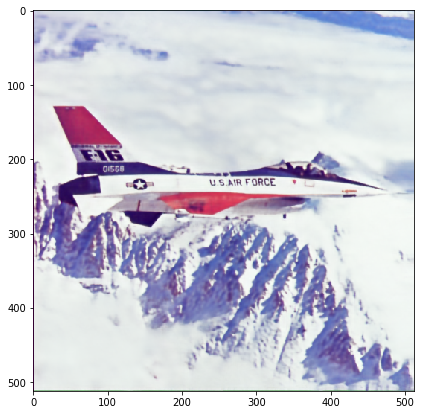

Iter # 1490 , PSRN NOISY:  26.99048515708474 ; PSRN GT:  20.392782490864512


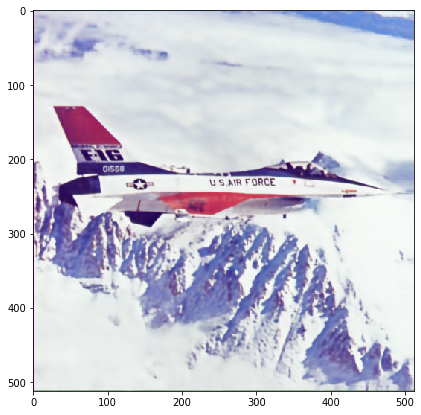

Iter # 1500 , PSRN NOISY:  26.95320886616428 ; PSRN GT:  20.35970974196699


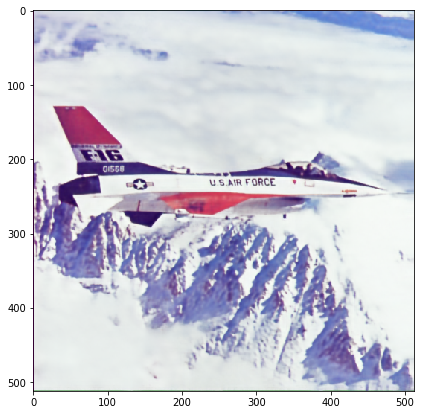

Iter # 1510 , PSRN NOISY:  26.853511505930648 ; PSRN GT:  20.79197610316601


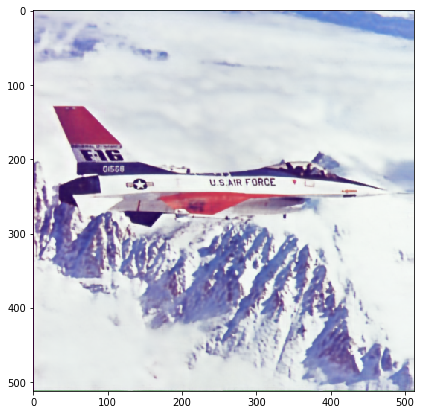

Iter # 1520 , PSRN NOISY:  27.1284883441701 ; PSRN GT:  20.387178197897995


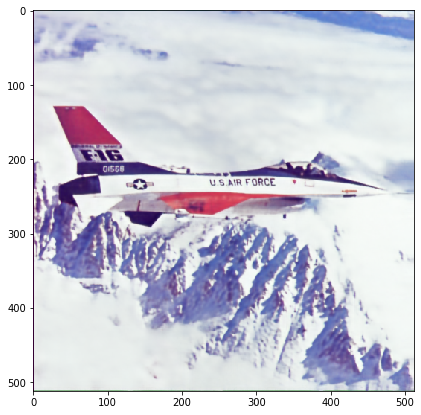

Iter # 1530 , PSRN NOISY:  27.075759366946343 ; PSRN GT:  20.433472713758416


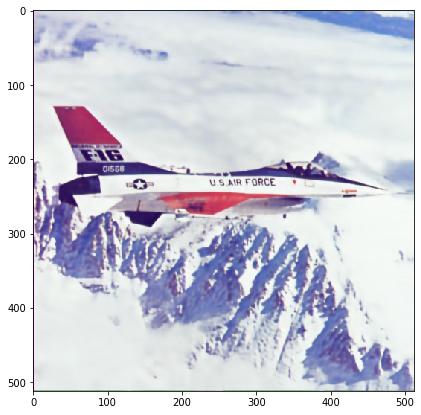

Iter # 1540 , PSRN NOISY:  27.062083604628327 ; PSRN GT:  20.251331932793324


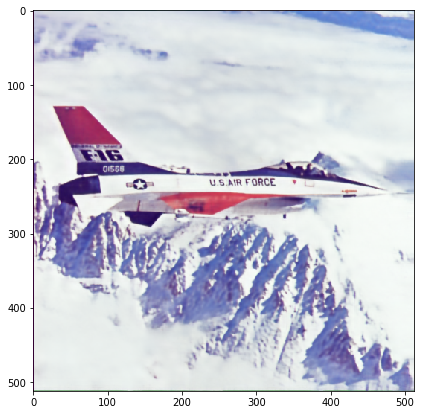

Iter # 1550 , PSRN NOISY:  26.94089802024508 ; PSRN GT:  20.541665568209385


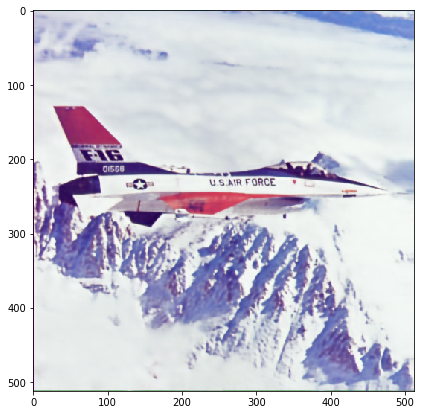

Iter # 1560 , PSRN NOISY:  26.84656857807488 ; PSRN GT:  20.678871262813377


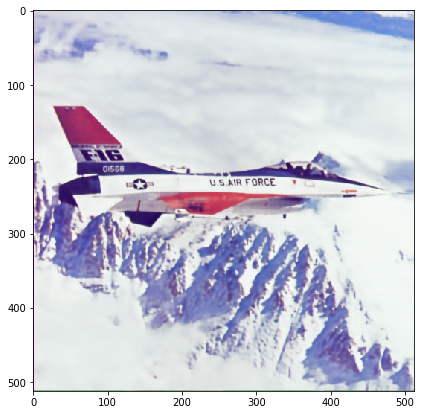

Iter # 1570 , PSRN NOISY:  27.047377232959136 ; PSRN GT:  20.24469017357997


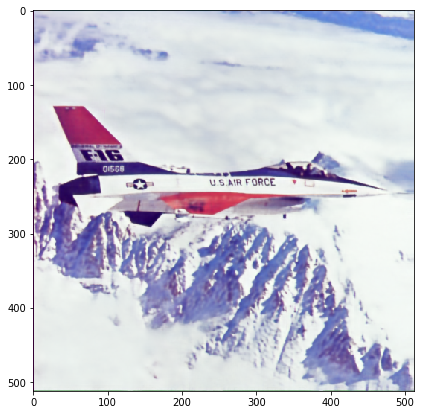

Iter # 1580 , PSRN NOISY:  27.08477215168596 ; PSRN GT:  20.38979625348043


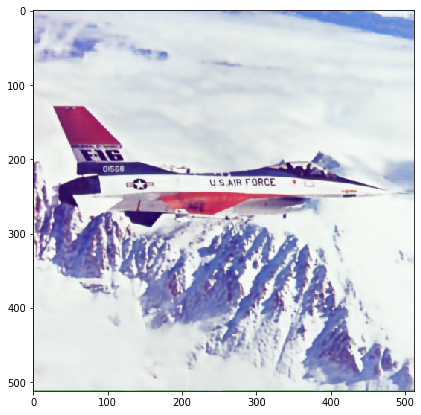

Iter # 1590 , PSRN NOISY:  27.088401552973554 ; PSRN GT:  19.934498445039296


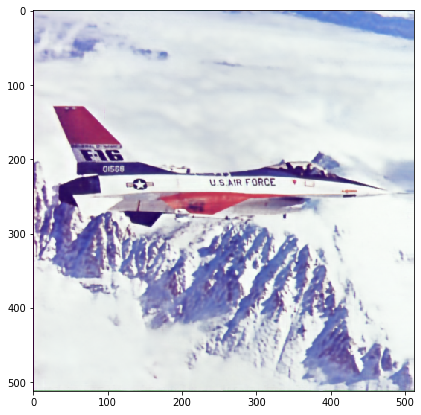

Iter # 1600 , PSRN NOISY:  27.081942805726975 ; PSRN GT:  20.443056243709137


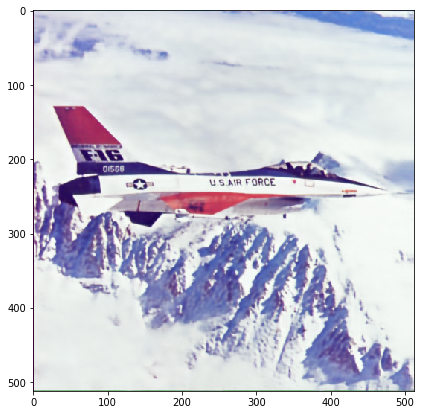

Iter # 1610 , PSRN NOISY:  27.067891753078094 ; PSRN GT:  20.178404309537402


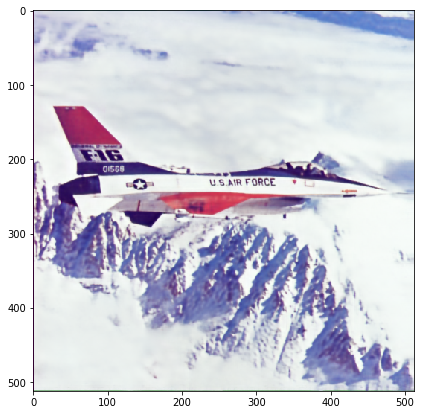

Iter # 1620 , PSRN NOISY:  27.145282759588383 ; PSRN GT:  20.394097944985088


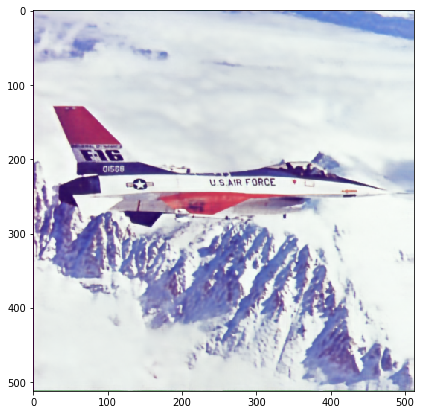

Iter # 1630 , PSRN NOISY:  27.159495854862623 ; PSRN GT:  20.302454337338872


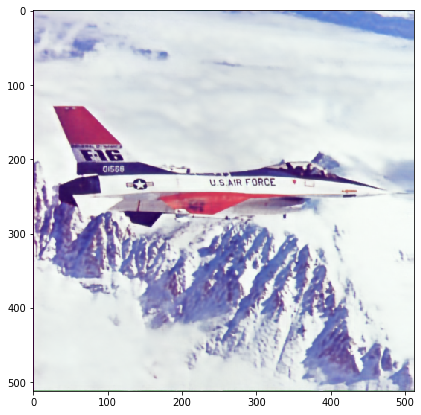

Iter # 1640 , PSRN NOISY:  27.134209606547817 ; PSRN GT:  20.51526875776098


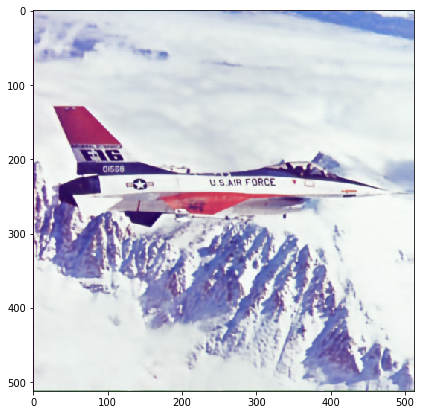

Iter # 1650 , PSRN NOISY:  27.03523240484376 ; PSRN GT:  20.43167378036592


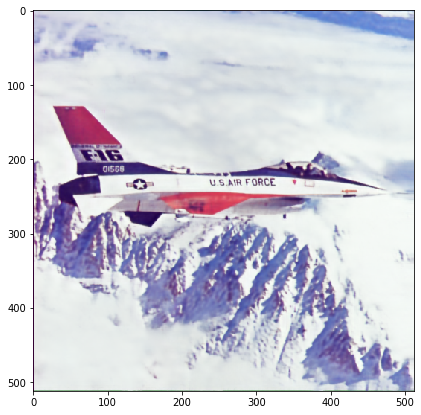

Iter # 1660 , PSRN NOISY:  27.044691815999748 ; PSRN GT:  20.505481790751517


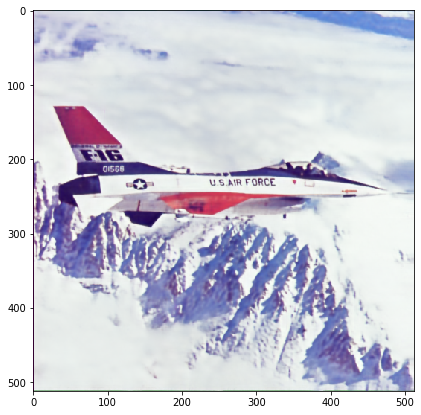

Iter # 1670 , PSRN NOISY:  27.095052771261106 ; PSRN GT:  20.628267559723426


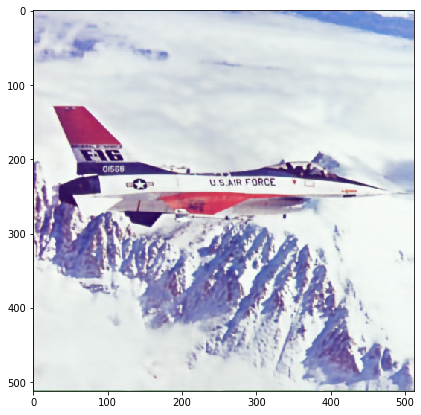

Iter # 1680 , PSRN NOISY:  26.93549529325608 ; PSRN GT:  20.69428743020002


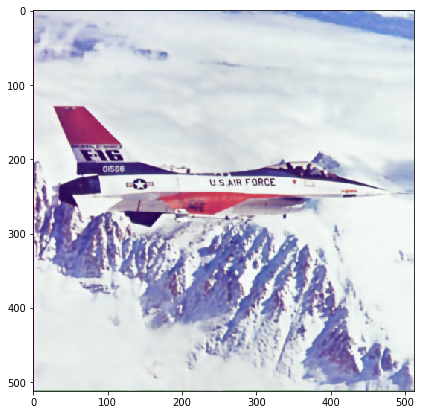

Iter # 1690 , PSRN NOISY:  27.04949250191486 ; PSRN GT:  20.61242702550019


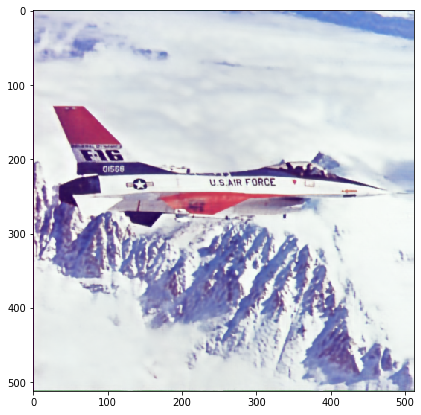

Iter # 1700 , PSRN NOISY:  27.15900137696993 ; PSRN GT:  20.229366293546093


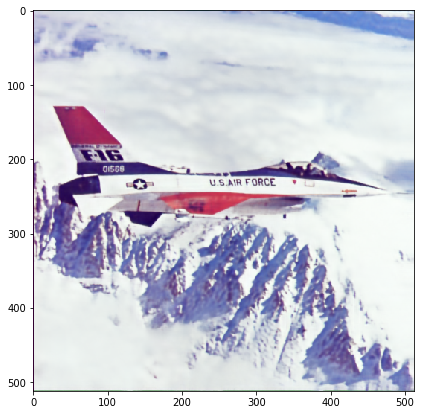

Iter # 1710 , PSRN NOISY:  27.166625434480647 ; PSRN GT:  20.49092181728352


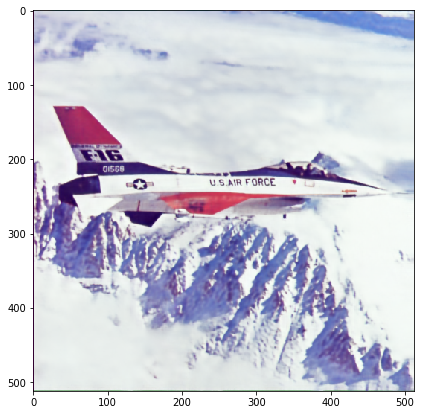

Iter # 1720 , PSRN NOISY:  27.033373180086734 ; PSRN GT:  20.626977680329368


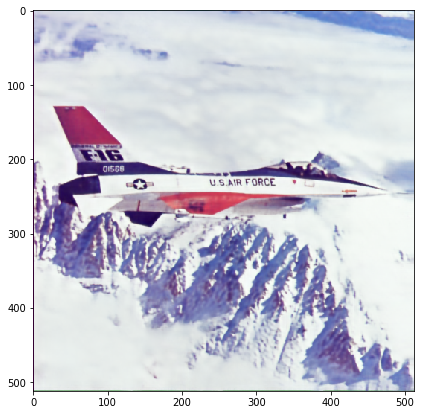

Iter # 1730 , PSRN NOISY:  27.093453963120485 ; PSRN GT:  20.567856490025605


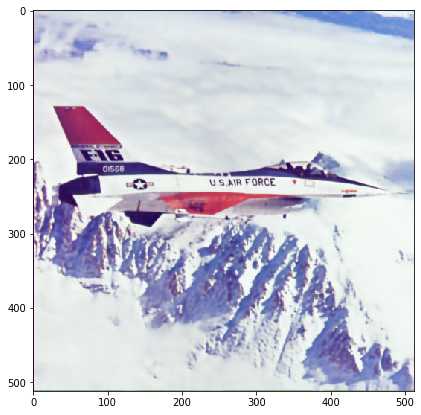

Iter # 1740 , PSRN NOISY:  27.177507226079527 ; PSRN GT:  20.50034651912984


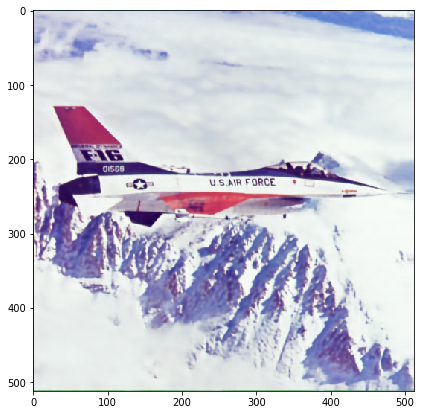

Iter # 1750 , PSRN NOISY:  27.158266894891334 ; PSRN GT:  20.329298160280118


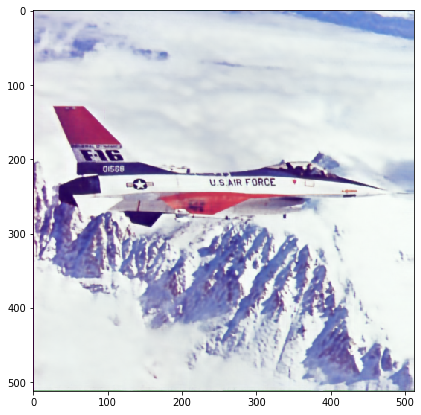

Iter # 1760 , PSRN NOISY:  27.269802211669894 ; PSRN GT:  20.15074639693633


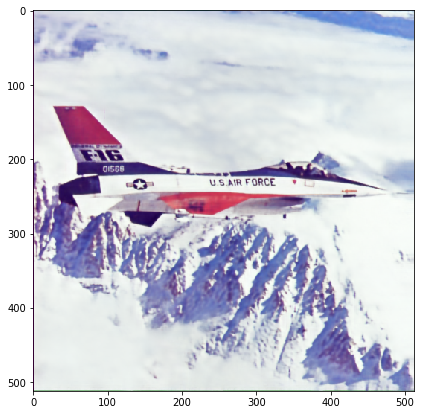

Iter # 1770 , PSRN NOISY:  27.164544967068824 ; PSRN GT:  20.41700155480592


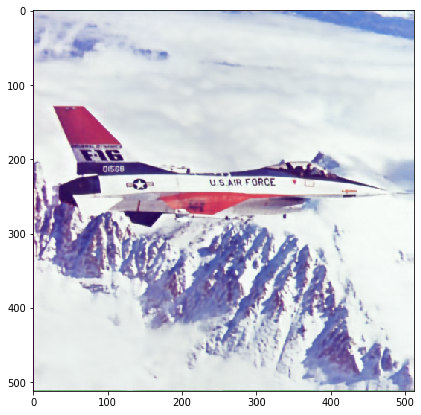

Iter # 1780 , PSRN NOISY:  27.27968355641933 ; PSRN GT:  20.311244346724152


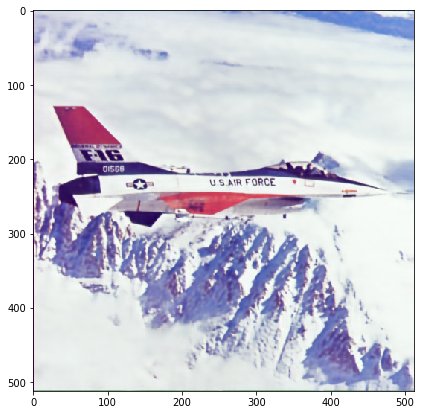

Iter # 1790 , PSRN NOISY:  27.260441134126197 ; PSRN GT:  20.28573310488143


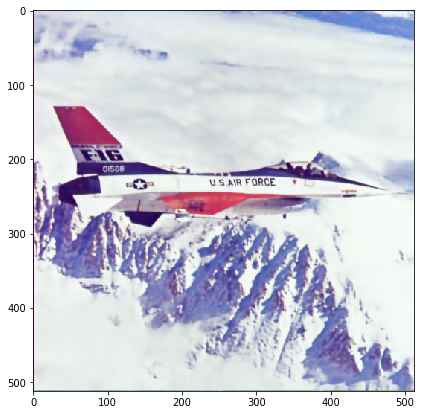

In [16]:
for i in range(1800):
    model.train_on_batch(input_noise + np.random.normal(0, 1/30.0, (height, width, 32)), image_noisy[None, :, :, :])
    
    if i % 10 == 0:
        out = np.clip(model.predict(input_noise)[0], 0, 255).astype(np.uint8)
        
        psrn_noisy = compare_psnr(image_noisy, out) 
        psrn_gt = compare_psnr(image, out)
        print("Iter #", i, ", PSRN NOISY: ", psrn_noisy, "; PSRN GT: ", psrn_gt)
        
        plt.figure(figsize=(7, 7))
        plt.imshow(out[:,:,::-1])
        plt.show()


In [ ]:
noisy_name = sys.argv[1]
denoised_name = sys.argv[2]

noisy_image = cv2.imread(noisy_name)
denoised_image = denoising(noisy_image)
cv2.imwrite(denoised_name, denoised_image)

In [30]:
import keras
import pydot
import pydotplus
import graphviz
from keras.utils.vis_utils import model_to_dot
keras.utils.vis_utils.pydot = pydot

from keras.utils.vis_utils import plot_model


In [33]:
plot_model(model, to_file='denoise_model.png', show_shapes=True, show_layer_names=True)

In [34]:
model.save("model_denoise.h5")

In [ ]:
from keras.models import load_model
model = load_model('model_denoise.h5')